In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split, KFold, cross_val_score, GridSearchCV, ParameterGrid
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn import metrics, tree

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
data = pd.read_csv('E:/Downloads/mobile_data.csv')
data

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,1,0.5,1,0,1,2,0.8,106,6,14,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,3,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,3,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,5,336,670,869,18,10,19,1,1,1,0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

*None of the columns is of "str" type.*

In [5]:
data.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,9.916500,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,6.064315,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,0.000000,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,5.000000,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,10.000000,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,15.000000,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,20.000000,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


### **Data Exploration and Visualization**

In [6]:
plt.style.use('seaborn')

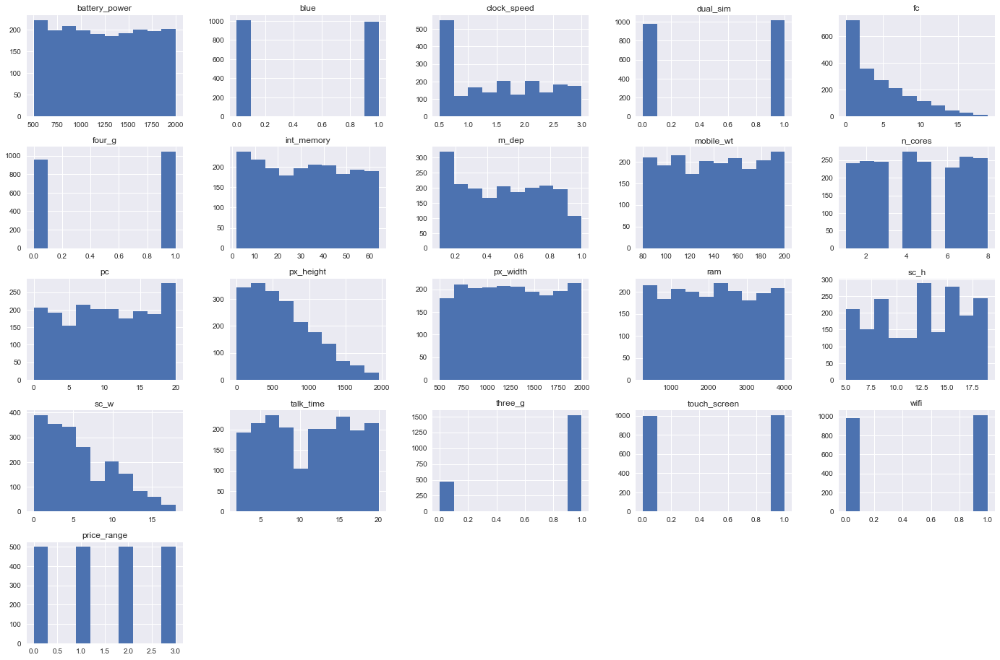

In [7]:
data.hist(figsize = (24, 16))
plt.show()

*---As it can be seen, except **"three_g"**, distributions in all other features are balanced, as well as the classes of the target.*  
*---Note that, 6 features are of boolean type. These features are **"blue"**, **"dual_sim"**, **"four_g"**, **"three_g"**, **"touch_screen"**, and **"wifi"**. In addition, values of the feature **"n_cores"** are discrete.*

In [8]:
# Splitting continuous features and discrete ones for further exploration and visualization.

disc_features = ['blue', 'dual_sim', 'four_g', 'three_g', 'touch_screen', 'wifi', 'n_cores']
cont_features = [col for col in data.columns if col not in disc_features + ['price_range']]
len(cont_features) + len(disc_features)

20

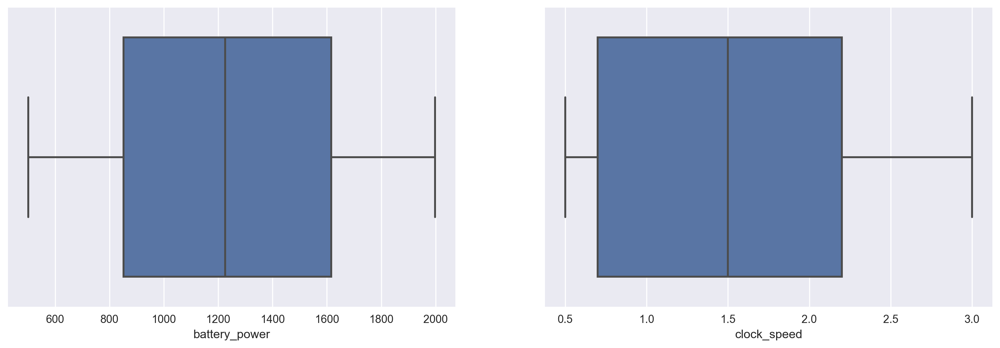

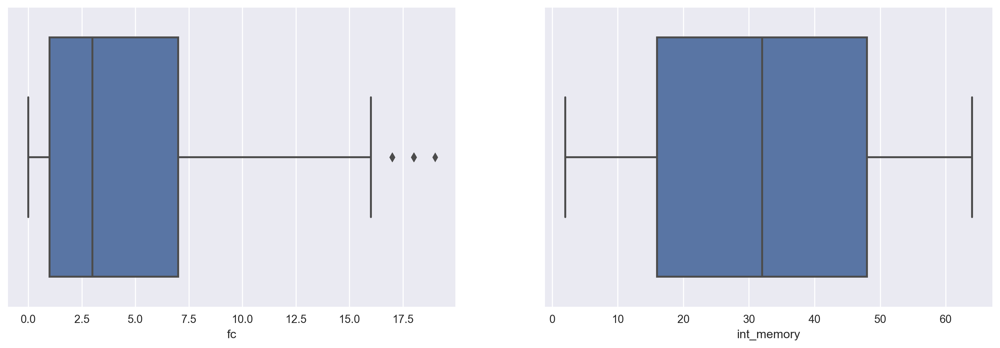

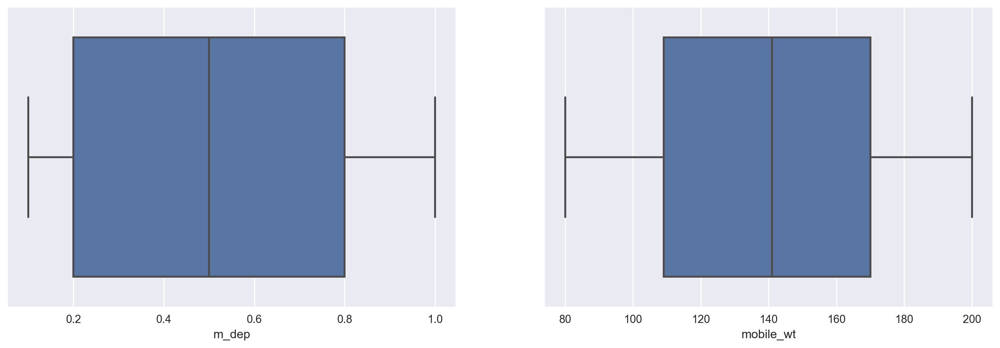

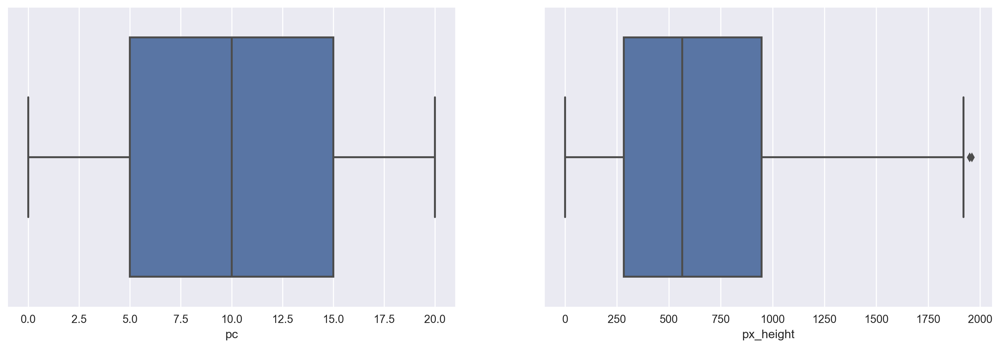

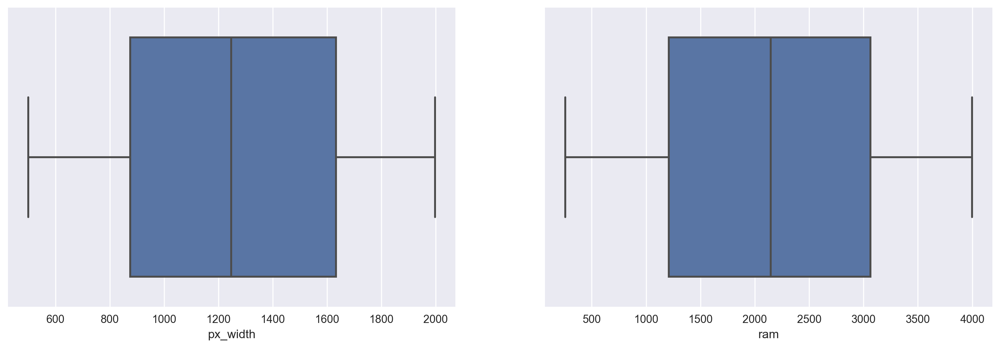

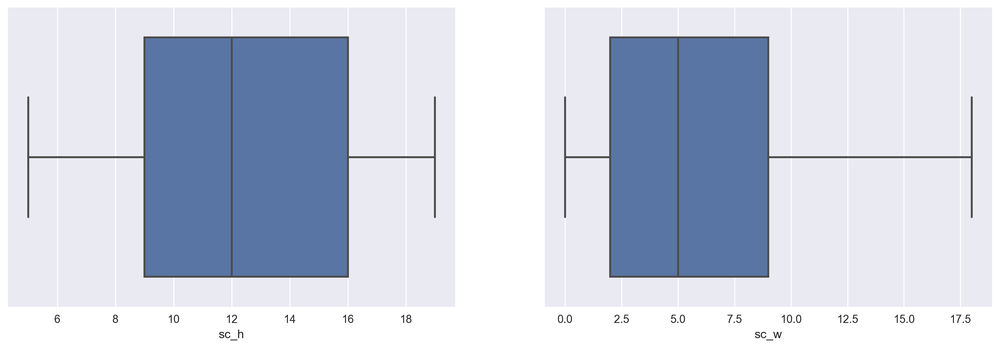

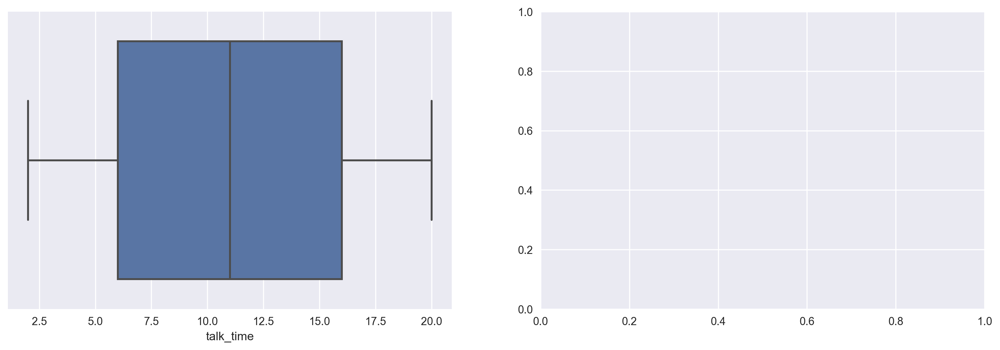

In [9]:
i = 0
while i < len(cont_features):
    try:
        fig = plt.figure(figsize = (16, 5), dpi = 250)
        plt.subplot(1,2,1)
        sns.boxplot(x = cont_features[i], data = data)
        i += 1
        plt.subplot(1,2,2)
        sns.boxplot(x = cont_features[i], data = data)
        i += 1
    except:
        continue
plt.show()

*Based on the box plots, there are few numbers of outliers in **"fc"** and **"px_height"** columns. However, the distance between these outliers and the rest of the data is not significant.*

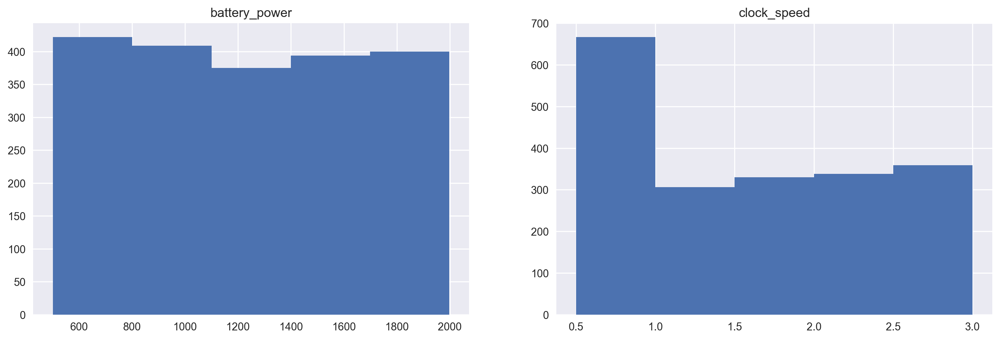

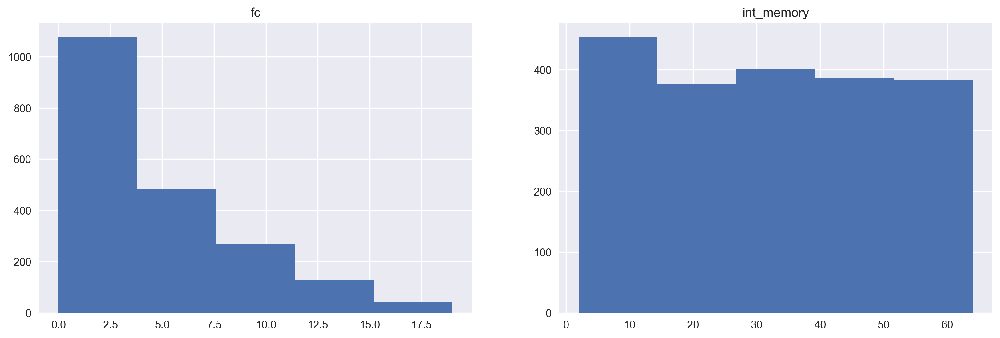

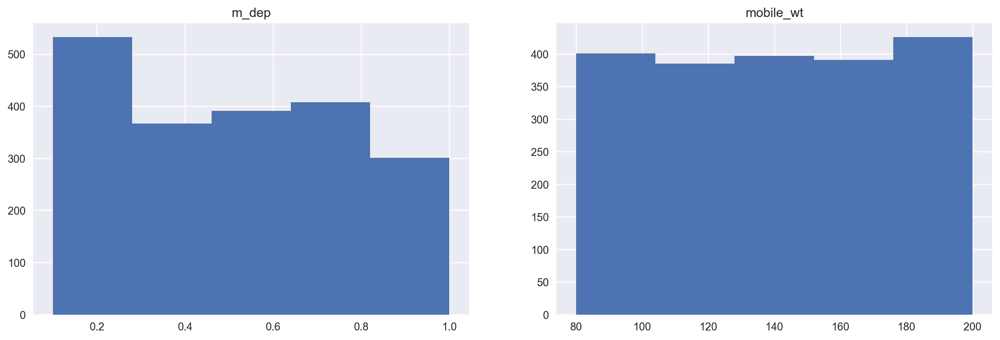

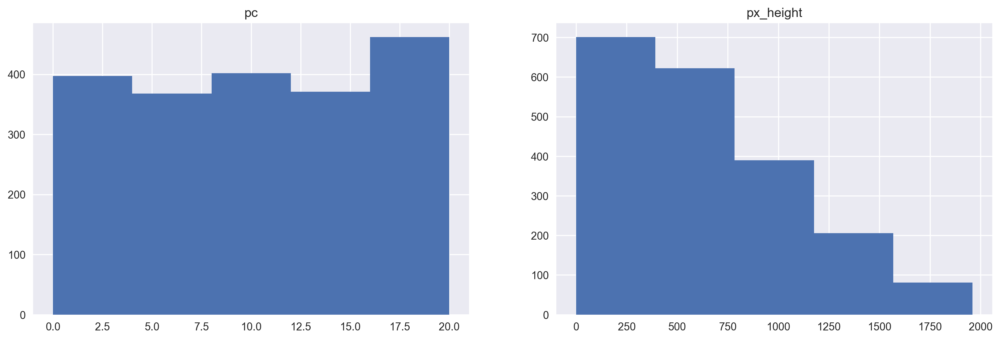

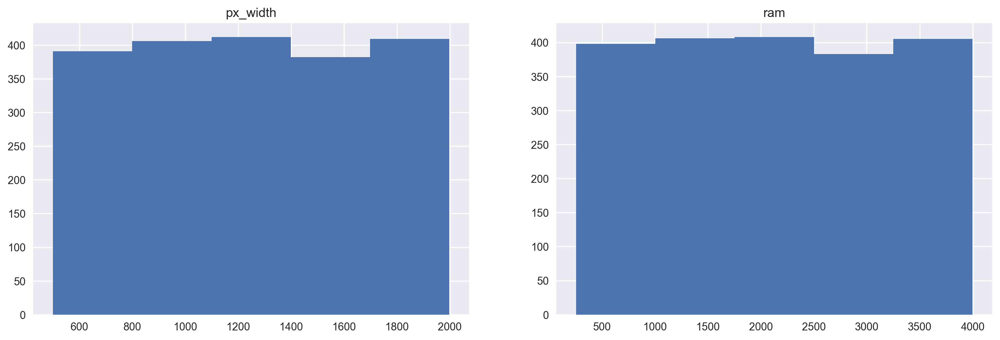

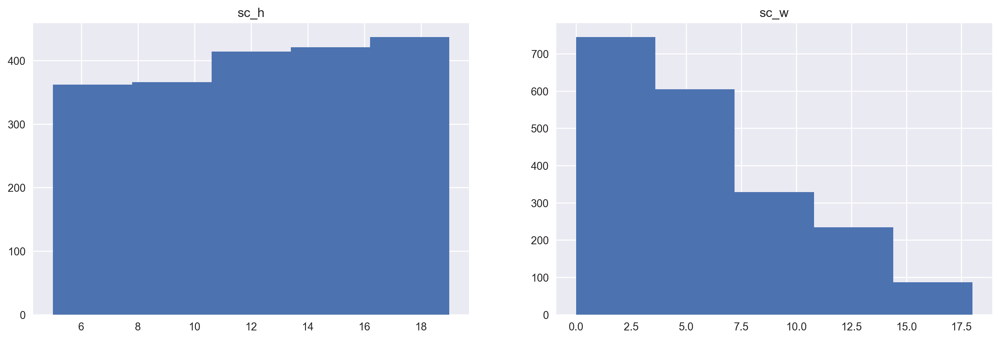

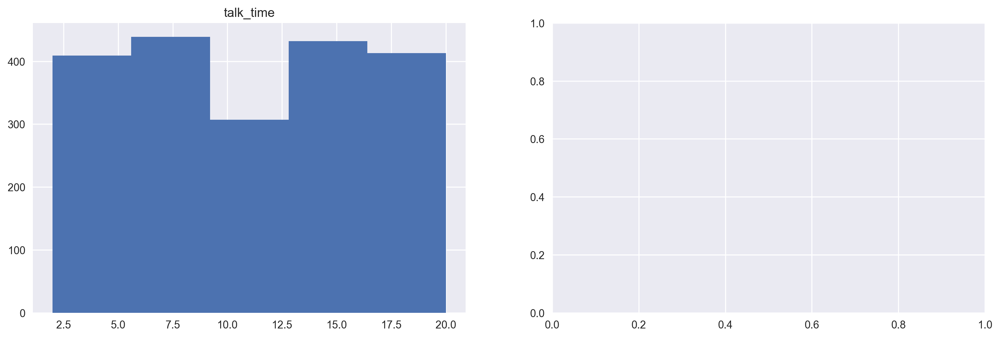

In [10]:
i = 0
while i < len(cont_features):
    try:
        fig = plt.figure(figsize = (16, 5), dpi = 250)
        plt.subplot(1,2,1)
        plt.hist(data[cont_features[i]], bins = 5)
        plt.title(cont_features[i])
        i += 1
        plt.subplot(1,2,2)
        plt.hist(data[cont_features[i]], bins = 5)
        plt.title(cont_features[i])
        i += 1
    except:
        continue
plt.show()

*Regarding the plots above, there are values equal to zero in both **"px_height"** and **"sc_w"**. The problem with these points is that **they cannot represent a feature** of a mobile phone, as there is no 1D pixel or a 1D screen !*

In [11]:
px_mask = data['px_height'] == 0
sc_mask = data['sc_w'] == 0
print(f'pixel height = 0  :  {sum(px_mask)}')
print(f'screen width = 0  :  {sum(sc_mask)}')

pixel height = 0  :  2
screen width = 0  :  180


*As the number of zeros in **"px_height"** is negligible, the related rows **can be removed**. But, regarding **"sc_w"**,the number of samples with a missing value is as many as **removing** those samples **may not be the best way** to deal with.*

In [12]:
data['px_height'] = data['px_height'].replace(0, np.nan)
data['px_height'].isnull().sum()

2

In [13]:
data.dropna(inplace = True)
data.reset_index(drop = True, inplace = True)

In [14]:
sc_mask = data['sc_w'] == 0
data[sc_mask == False]['sc_w'].agg(['min', 'max', 'mean', 'median', 'var', 'std'])

min        1.000000
max       18.000000
mean       6.338098
median     6.000000
var       17.248113
std        4.153085
Name: sc_w, dtype: float64

*Comparing **"std" with "mean"**, the values in **"sc_w"** column are **not varied much**. However, due to the relatively big difference between **"min"** and **"max"**, using univariate imputation methods are not reasonable. So, a logical approach for using **KNNImputer** is being implemented.*

### **Imputation using KNNImputer**

In [15]:
data['sc_w'] = data['sc_w'].replace(0, np.nan)
mask = data['sc_w'].isnull()

In [16]:
# Splitting that part of data without missing values for fitting and evaluation purposes.

data_no_mv = data[sc_mask == False]
X_train, X_test = train_test_split(data_no_mv, test_size = 0.2, shuffle = True, random_state = 1)
print(f'{len(X_train)}, {len(X_test)}')

1455, 364


In [17]:
# Defining train dataframe for fitting the algorithm on, and true values of the target column in train
# and test part.

sc_true_train = X_train['sc_w'].copy()
sc_true_test = X_test['sc_w'].copy()

In [18]:
sc_train_mv = np.array([np.nan for i in range(1455)])
sc_test_mv = np.array([np.nan for i in range(364)])

In [19]:
train_evaluation_set = X_train.copy()
train_evaluation_set['sc_w'] = sc_train_mv
X_test['sc_w'] = sc_test_mv
test_evaluation_set = X_test

<ipython-input-19-c04c36bdf684>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['sc_w'] = sc_test_mv


##### *Each of the sets above is being used for a specific purpose :*
--- **X_train** : *to fit the imputer on.*

--- **train_evaluation_set** : *to transform using the fitted imputer for evaluting the performance on the train set.*

--- **test_evaluation_set** : *to transform using the fitted imputer for evaluting the performance on the test set.*

--- **sc_true_train** : *to compare the transformed data frame with the original values on the train set.*

--- **sc_true_test** : *to compare the transformed data frame with the original values on the test set.*

In [20]:
params = {'n_neighbors' : [2, 5, 10, 15, 20], 'weights' : ['uniform', 'distance']}

In [21]:
for parameters in ParameterGrid(params):
    imputer = KNNImputer(**parameters)
    imputer.fit(X_train)
    train_set = train_evaluation_set.copy()
    test_set = test_evaluation_set.copy()
    train_set, test_set = imputer.transform(train_set), imputer.transform(test_set)
    train_set = pd.DataFrame(train_set, columns = data.columns)
    test_set = pd.DataFrame(test_set, columns = data.columns)
    sc_pred_train, sc_pred_test = train_set['sc_w'], test_set['sc_w']
    train_score = metrics.r2_score(sc_true_train, sc_pred_train)
    test_score = metrics.r2_score(sc_true_test, sc_pred_test)
    train_error = np.sqrt(metrics.mean_squared_error(sc_true_train, sc_pred_train))
    test_error = np.sqrt(metrics.mean_squared_error(sc_true_test, sc_pred_test))
    print(f'{parameters} / train score : {round(train_score, 2)} / train_error : {round(train_error, 2)} / test score : {round(test_score, 2)} / test_error : {round(test_error, 2)}')

{'n_neighbors': 2, 'weights': 'uniform'} / train score : 0.46 / train_error : 3.05 / test score : -0.54 / test_error : 5.06
{'n_neighbors': 2, 'weights': 'distance'} / train score : 1.0 / train_error : 0.0 / test score : -0.55 / test_error : 5.08
{'n_neighbors': 5, 'weights': 'uniform'} / train score : 0.15 / train_error : 3.84 / test score : -0.22 / test_error : 4.5
{'n_neighbors': 5, 'weights': 'distance'} / train score : 1.0 / train_error : 0.0 / test score : -0.22 / test_error : 4.5
{'n_neighbors': 10, 'weights': 'uniform'} / train score : 0.09 / train_error : 3.97 / test score : -0.1 / test_error : 4.28
{'n_neighbors': 10, 'weights': 'distance'} / train score : 1.0 / train_error : 0.0 / test score : -0.11 / test_error : 4.3
{'n_neighbors': 15, 'weights': 'uniform'} / train score : 0.06 / train_error : 4.04 / test score : -0.04 / test_error : 4.17
{'n_neighbors': 15, 'weights': 'distance'} / train score : 1.0 / train_error : 0.0 / test score : -0.06 / test_error : 4.19
{'n_neighbor

*KNNImputer did **not** yield **good results**, so it will **not be used** as a mean of imputation.*

In [22]:
mask = data['sc_w'].notnull()
data[mask].corr()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
battery_power,1.000000,0.028427,0.002404,-0.046804,0.027073,0.019110,-0.006117,0.034156,0.013188,-0.027528,0.025015,0.014913,-0.003276,-0.006012,-0.045429,-0.022470,0.054556,0.006958,-0.003072,-0.003869,0.193879
blue,0.028427,1.000000,0.019489,0.019176,-0.002040,0.010108,0.043189,0.015424,-0.027056,0.031019,-0.014135,-0.009228,-0.047580,0.030990,-0.014699,-0.026137,0.016415,-0.025636,0.000444,-0.022741,0.028674
clock_speed,0.002404,0.019489,1.000000,-0.007587,-0.005444,-0.037220,0.005311,-0.011987,-0.001745,-0.015042,-0.008417,-0.007822,-0.001906,0.005045,-0.024307,-0.003585,-0.023237,-0.043171,0.030253,-0.021255,-0.003857
dual_sim,-0.046804,0.019176,-0.007587,1.000000,-0.026693,-0.007614,-0.019762,-0.015795,-0.003877,-0.016586,-0.023793,-0.027274,0.009516,0.048586,-0.009149,-0.003807,-0.029948,-0.016671,-0.012785,0.023397,0.022761
fc,0.027073,-0.002040,-0.005444,-0.026693,1.000000,-0.017502,-0.032046,-0.002887,0.032649,-0.021467,0.645880,-0.001558,-0.004116,0.011863,-0.012501,-0.017689,-0.018639,-0.008233,-0.018766,0.006102,0.017528
four_g,0.019110,0.010108,-0.037220,-0.007614,-0.017502,1.000000,0.016302,-0.013123,-0.001856,-0.012332,-0.006187,-0.020834,0.008392,0.009307,0.030066,0.032997,-0.052652,0.588766,0.004227,-0.017288,0.014578
int_memory,-0.006117,0.043189,0.005311,-0.019762,-0.032046,0.016302,1.000000,-0.006389,-0.024652,-0.028032,-0.037135,0.005584,-0.006458,0.037720,0.035625,0.005413,-0.005081,-0.000860,-0.022484,0.011921,0.051512
m_dep,0.034156,0.015424,-0.011987,-0.015795,-0.002887,-0.013123,-0.006389,1.000000,0.030750,-0.003778,0.027840,0.034922,0.034770,-0.011836,-0.031653,-0.011278,0.019228,-0.015047,0.006672,-0.027216,0.003151
mobile_wt,0.013188,-0.027056,-0.001745,-0.003877,0.032649,-0.001856,-0.024652,0.030750,1.000000,-0.014654,0.028541,0.003140,0.009456,-0.000663,-0.040303,-0.038367,0.009354,0.007333,-0.011447,-0.004352,-0.023780
n_cores,-0.027528,0.031019,-0.015042,-0.016586,-0.021467,-0.012332,-0.028032,-0.003778,-0.014654,1.000000,-0.006213,0.001256,0.025480,-0.014830,0.000167,0.021724,0.007751,-0.007316,0.028754,-0.019714,-0.009938


*Based on the table above, **"sc_w"** is not correlated with any other feature **except "sc_h"**, so simple regression imputation methods cannot be implemented. As a result, rows which does not include any value for "sc_w" are being **removed** from the original dataset.*

##### As the instructor of this course asked, column **"sc_w"** will be removed from the data and it will not be used for training models.

In [23]:
data.drop('sc_w', axis = 1, inplace = True)
data

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20.0,756,2549,9,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905.0,1988,2631,17,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263.0,1716,2603,11,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216.0,1786,2769,16,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208.0,1212,1411,8,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1993,794,1,0.5,1,0,1,2,0.8,106,6,14,1222.0,1890,668,13,19,1,1,0,0
1994,1965,1,2.6,1,0,0,39,0.2,187,4,3,915.0,1965,2032,11,16,1,1,1,2
1995,1911,0,0.9,1,1,1,36,0.7,108,8,3,868.0,1632,3057,9,5,1,1,0,3
1996,1512,0,0.9,0,4,1,46,0.1,145,5,5,336.0,670,869,18,19,1,1,1,0


### **More Visialization and Analysis**

*Now that the data has been cleansed from all the missing values, the aformentioned outliers in **"fc"** and **"px_height"** columns are being explorated.*

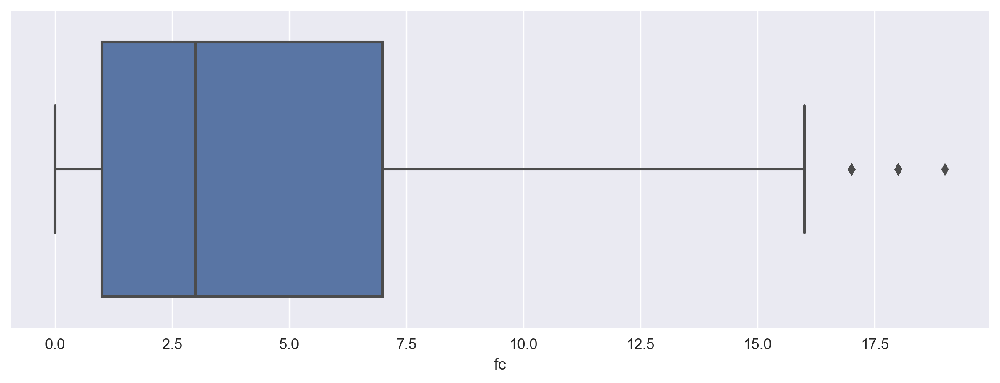

In [24]:
plt.figure(figsize = (12, 4), dpi = 250)
sns.boxplot(x = 'fc', data = data)
plt.show()

In [25]:
data['fc'].value_counts()

0     474
1     245
2     189
3     169
5     139
4     133
6     112
7      99
9      78
8      77
10     62
11     51
12     45
13     40
16     24
15     23
14     20
18     11
17      6
19      1
Name: fc, dtype: int64

*As there is **no logical reason** to consider any of the values in "fc" column as a noise, the column is being kept **intact**.*

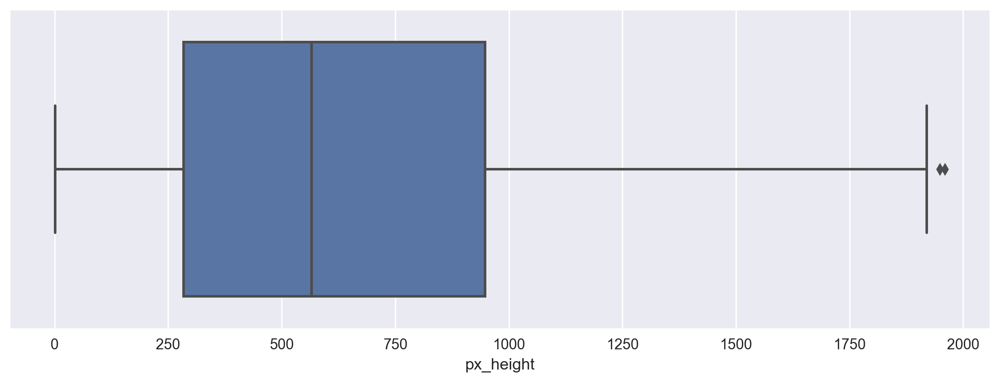

In [26]:
plt.figure(figsize = (12, 4), dpi = 250)
sns.boxplot(x = 'px_height', data = data)
plt.show()

In [27]:
data['px_height'].nlargest(8)

1770    1960.0
988     1949.0
894     1920.0
260     1914.0
1163    1901.0
1826    1899.0
1017    1895.0
1397    1878.0
Name: px_height, dtype: float64

*None of the outlier samples that had been represented in the box plot, is **a noise**, cause **the difference** between those samples and other samples is **not significant**.*

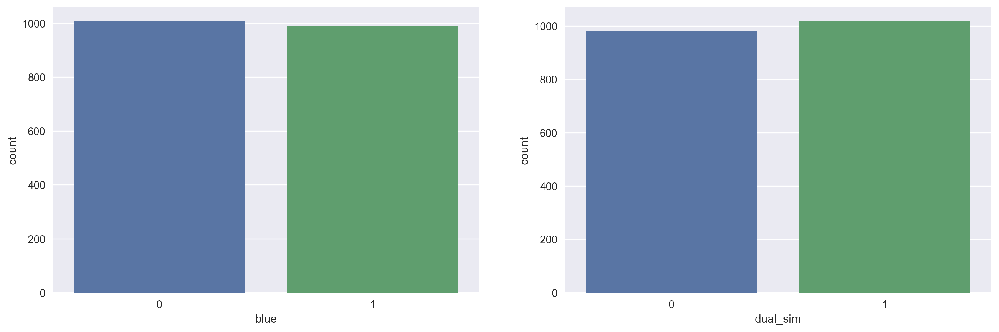

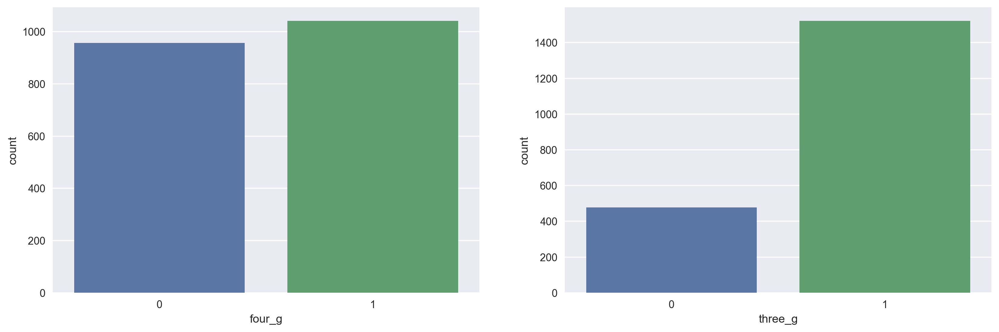

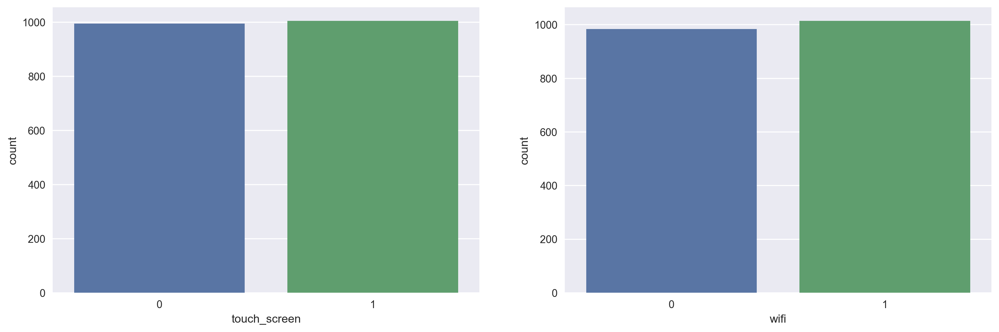

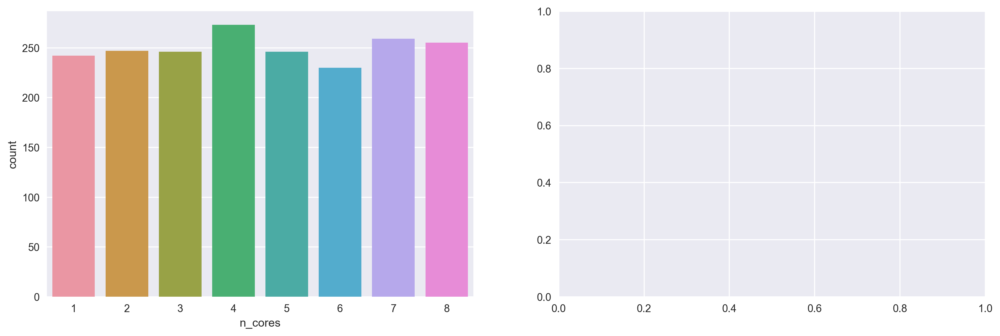

In [28]:
i = 0
while i < len(disc_features):
    try:
        fig = plt.figure(figsize = (16, 5), dpi = 250)
        plt.subplot(1,2,1)
        sns.countplot(x = disc_features[i], data = data)
        i += 1
        plt.subplot(1,2,2)
        sns.countplot(x = disc_features[i], data = data)
        i += 1
    except:
        continue
plt.show()

*Except **"three_g"** column, values in other discrete columns has **uniform distribution**.*

In [29]:
# Searching for any logical effect of presence or absence of discrete features on the target. Run this 
# cell several times to check for all of the discrete features.

i = 6  #insert 0 to 6 to see the results.
grp = data.groupby([disc_features[i]])
print(disc_features[i])
grp['price_range'].value_counts(normalize = True)

n_cores


n_cores  price_range
1        1              0.314050
         3              0.268595
         2              0.214876
         0              0.202479
2        0              0.279352
         3              0.251012
         1              0.238866
         2              0.230769
3        1              0.280488
         0              0.252033
         3              0.239837
         2              0.227642
4        1              0.278388
         2              0.267399
         0              0.245421
         3              0.208791
5        3              0.284553
         2              0.268293
         0              0.239837
         1              0.207317
6        0              0.265217
         3              0.252174
         2              0.247826
         1              0.234783
7        2              0.266409
         3              0.266409
         0              0.254826
         1              0.212355
8        2              0.274510
         0            

### Groupby objects yields the following result :
#### 
*--- In almost all groups the target classes are spreaded equally. That mean, the differences are not much.*

*--- In the group with **"blue" = 1**, the weight of the target class **3** is slightly **more** than the other classes.*

*--- In the group with **"dual_sim" = 0**, the weight of the target calss **3** is slightly **less** than the other classes.*

*--- In the group with **"dual_sim" = 1**, the weight of the target class **3** is slightly **more** than the other groups.*

*--- In the group with **"four_g" = 0**, the weight of the target calss **2** is slightly **more** than the other classes, and the weight of the target class **3** is **less** than the others.*

*--- In the group with **"four_g" = 1**, the weight of the target calss **3** is slightly **more** than the other classes, and the weight of the target class **2** is **less** than the others.*

*--- In the group with **"three_g" = 0**, the weight of the target calss **0** is slightly **more** than the other classes, and the weight of the target class **2** is **less** than the others.*

*--- In the group with **"touch_screen" = 0**, the weight of the target calss **2** is slightly **more** than the other classes, and the weight of the target class **0** is **less** than the others!*

*--- In the group with **"touch_screen" = 1**, the weight of the target calss **0** is slightly **more** than the other classes , and the weight of the target class **2** is **less** than the others!*

*--- It might not be logical, but phones without touch screen are more expensive in this data set!*

*--- In the groups by **"wifi"**, all of the target classes has almost the **same** weight.*

*---The differences in the groups formed based on the "n_cores" column, are more than other columns. However, the weights are not logically explainable.*

In [30]:
target_grp = data.groupby(['price_range'])

In [31]:
cont_features.remove('sc_w')

In [32]:
target_grp.describe(percentiles = [0.5])[cont_features]

battery_power                                                  \
                    count         mean         std    min     50%     max   
price_range                                                                 
0                   500.0  1116.902000  410.801305  503.0  1066.0  1994.0   
1                   499.0  1229.533066  438.802249  501.0  1208.0  1996.0   
2                   500.0  1228.320000  452.863065  501.0  1219.5  1998.0   
3                   499.0  1379.074148  414.909208  503.0  1448.0  1994.0   

            clock_speed                                         fc            \
                  count      mean       std  min   50%  max  count      mean   
price_range                                                                    
0                 500.0  1.550200  0.848941  0.5  1.55  3.0  500.0  4.084000   
1                 499.0  1.487575  0.814974  0.5  1.50  3.0  499.0  4.342685   
2                 500.0  1.529800  0.804404  0.5  1.50  3.0  500.0  4.498000   
3                 499.0  1.519238  0.796825  0.5  1.50  3.0  499.0  4.310621   

                                      int_memory                             \
                  std  min  50%   max      count       mean        std  min   
price_range                                                                   
0            4.183772  0.0  3.0  19.0      500.0  31.174000  18.101023  2.0   
1            4.503546  0.0  3.0  18.0      499.0  32.176353  17.968093  2.0   
2            4.347390  0.0  3.0  18.0      500.0  30.920000  18.441958  2.0   
3            4.335075  0.0  3.0  18.0      499.0  33.963928  17.946336  2.0   

                         m_dep                                    mobile_wt  \
              50%   max  count      mean       std  min  50%  max     count   
price_range                                                                   
0            30.0  64.0  500.0  0.490200  0.288184  0.1  0.5  1.0     500.0   
1            32.0  64.0  499.0  0.523848  0.287162  0.1  0.5  1.0     499.0   
2            30.0  64.0  500.0  0.490800  0.286215  0.1  0.5  1.0     500.0   
3            34.0  64.0  499.0  0.502806  0.291637  0.1  0.5  1.0     499.0   

                                                           pc             \
                   mean        std   min    50%    max  count       mean   
price_range                                                                
0            140.552000  36.378319  80.0  142.0  200.0  500.0   9.574000   
1            140.482966  35.709633  80.0  141.0  200.0  499.0   9.923848   
2            143.614000  34.320326  80.0  145.0  200.0  500.0  10.018000   
3            136.394790  34.906911  80.0  134.0  200.0  499.0  10.148297   

                                       px_height                          \
                  std  min   50%   max     count        mean         std   
price_range                                                                
0            6.095805  0.0   9.5  20.0     500.0  536.408000  372.824164   
1            6.130952  0.0  10.0  20.0     499.0  668.228457  440.780200   
2            5.952861  0.0  10.0  20.0     500.0  632.284000  445.789232   
3            6.091509  0.0  10.0  20.0     499.0  746.340681  483.051524   

                                 px_width                                  \
              min    50%     max    count         mean         std    min   
price_range                                                                 
0             1.0  465.5  1878.0    500.0  1150.270000  413.001780  500.0   
1             2.0  607.0  1914.0    499.0  1252.424850  433.845224  500.0   
2            10.0  538.5  1960.0    500.0  1234.046000  427.757151  508.0   
3             4.0  674.0  1949.0    499.0  1368.601202  426.354091  501.0   

                               ram                                           \
                50%     max  count         mean         std     min     50%   
price_range                            

*--- Values in th column **"battery_power"** is almost linearly correlated with the target classes.*

*--- Oddly, target class **0** has the highest mean value of **"clock_speed"** !*

*--- Highest mean value of **"int_memory"** belong to the target classes **3** .*

*--- Lowest mean value of **"mobile_wt"** belongs to the target class **3**, and that sounds reasonable.*

*--- Column **"pc"** is linearly correlated with the target classes.*

*--- Highest mean value of **"px_height"** belongs to the target class **3**.*

*--- Highest mean value of **"px_width"** belongs to the target class **3**. That means, more expensive phones has better screen in terms of the pixel size.*

*--- Values in the column **"ram"** is highly and positively correlated with the target.*

*--- Mean value of **"sc_h"** is higher among samples of the target class **3**. However, for other classes there is no logical relation.*

In [ ]:
plt.figure(figsize = (130, 140), dpi = 200)
sns.pairplot(data[cont_features + ['price_range']] ,hue='price_range', palette='Dark2')
plt.savefig('mobile_data_pairplot.pdf', dpi = 1000)
plt.show()

### Pairplot Interpretations : 
##### ( plots are interpreted using the pdf with higher resolution)
##### (Output is cleared in order to reduce the size of the notebook.)
*--- Separability of target classes along the feature **"ram"** is the highest.*

*--- Classes **0** and **3** are quite separable from each other and the two other calsses along **"battery_power"**.*

*--- Along **"fc"**, **none** of the classes is separable from others.*

*--- Along **"px_width"**, classes are **more** separable **compared** to **other classes** except **"ram"**. But, the extent of separablity is **not** much.* 

*--- Features **"fc"** and **"pc"** are correlated to some extent.*

*--- Features **"px_height"** and **"px_width"** are somehow correlated.*

In [ ]:
fig, ax = plt.subplots(figsize = (24, 18), dpi = 300)
sns.heatmap(data.corr(), center = 1, cbar = True, annot = True, linewidths = 0.5, ax = ax)
plt.show()

##### (Output is cleared in order to reduce the size of the notebook.)
*--- As it can be seen from the heat map above, target classes are highly correlated with **"ram"**.*

*--- On the next levels, are features **"battery_power"**, **"px_height"** and **"px_width"**.*

*--- Apart from the aformentioned columns, correlation coefficient of other features with target classes are **below 0.05**.*

*--- Among other features, there are some almost high correaltion coefficients. These feature pairs are **"pc" and "fc"**, **"three_g" and "four_g"**, and **"px_width" and "px_height"**.*

### **Decision Tree**

In [38]:
# Returning the classification metrics for multi_class probelm.

def multi_class_metrics(y_true, y_pred):
    print(f'Accuracy  : ', round(metrics.accuracy_score(y_true, y_pred), 3))
    print(f'Precision : ', round(metrics.precision_score(y_true, y_pred, average = 'micro'), 3))
    print(f'Recall    : ', round(metrics.recall_score(y_true, y_pred, average = 'micro'), 3))
    print(f'f1        : ', round(metrics.f1_score(y_true, y_pred, average = 'micro'), 3))

In [39]:
X = data.drop('price_range', axis = 1)
y = data['price_range']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [40]:
dt = DecisionTreeClassifier(random_state = 1)
dt.fit(X_train, y_train)

DecisionTreeClassifier(random_state=1)

In [41]:
y_pred_train = dt.predict(X_train)
y_pred_test = dt.predict(X_test)

In [42]:
print('Train')
multi_class_metrics(y_train, y_pred_train)
print('\nTest')
multi_class_metrics(y_test, y_pred_test)

Train
Accuracy  :  1.0
Precision :  1.0
Recall    :  1.0
f1        :  1.0

Test
Accuracy  :  0.855
Precision :  0.855
Recall    :  0.855
f1        :  0.855


*--- It can be seen that without pruning, the model overfitted.*

*--- Considering that the target classes are **balanced**, **accuracy** is a reasonable metric to campare the models with.*

*--- As the target is non-binary, precision and recall scores, as well as f1 score, cannot be calcualted. So, the analysis should be done on the confusion matrix.*

In [ ]:
fig = plt.figure(figsize=(25,20), dpi = 600)
tree.plot_tree(dt, feature_names = X.columns, filled=True)
plt.show()

##### (Output is cleared in order to reduce the size of the notebook.)
*--- Inspecting the graph above, it can be seen that the problem of this tree is that most of the leaf nodes contain less than 5 sample. In addition, there are some internal nodes that one of the classes is obvoiusly dominant, but the tree goes to reach to a utterly pure node. However, in some of these cases the nodes are splitted correctly. As the result, I believe that limiting the maximum depth is not an efficient way to prune it, but tuning the hyperparameters that control the number of samples in internal nodes and leaf nodes might be a better approach.*

*--- Target hyperparamethers to tune : **min_smapels_split**, **min_smaples_leaf** and **criterion**.*

*--- Also, finding the optimal value for **ccp_alpha** might help with acheiving a better result.*

In [44]:
dt = DecisionTreeClassifier(random_state = 1)
params = {'min_samples_split' : list(range(10, 101, 10)), 'min_samples_leaf' : list(range(5, 51, 5)),
          'criterion' : ['gini', 'entropy']}
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(dt, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [45]:
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=1), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'min_samples_leaf': [5, 10, 15, 20, 25, 30, 35, 40, 45,
                                              50],
                         'min_samples_split': [10, 20, 30, 40, 50, 60, 70, 80,
                                               90, 100]},
             return_train_score=True, scoring='accuracy')

In [46]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(5)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_min_samples_leaf,param_min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
110,0.025930,0.002599,0.003790,0.000747,entropy,10,10,"{'criterion': 'entropy', 'min_samples_leaf': 1...",0.8500,0.8625,0.815,0.864662,0.842105,0.846853,0.017939,1,0.922403,0.920526,0.923655,0.921826,0.933709,0.924424,0.004750
111,0.025733,0.003418,0.004184,0.000744,entropy,10,20,"{'criterion': 'entropy', 'min_samples_leaf': 1...",0.8500,0.8625,0.815,0.864662,0.842105,0.846853,0.017939,1,0.922403,0.920526,0.923655,0.921826,0.933709,0.924424,0.004750
101,0.024334,0.001198,0.004789,0.003117,entropy,5,20,"{'criterion': 'entropy', 'min_samples_leaf': 5...",0.8425,0.8525,0.825,0.859649,0.849624,0.845855,0.011788,3,0.927409,0.925532,0.929287,0.926829,0.939962,0.929804,0.005221
122,0.021933,0.000885,0.003193,0.000401,entropy,15,30,"{'criterion': 'entropy', 'min_samples_leaf': 1...",0.8325,0.8550,0.820,0.872180,0.842105,0.844357,0.018035,4,0.910513,0.900501,0.906133,0.899937,0.905566,0.904530,0.003918
120,0.021942,0.001092,0.003595,0.000795,entropy,15,10,"{'criterion': 'entropy', 'min_samples_leaf': 1...",0.8325,0.8550,0.820,0.872180,0.842105,0.844357,0.018035,4,0.910513,0.900501,0.906133,0.899937,0.905566,0.904530,0.003918


*Regarding the results above, a range for each parameter has been obtained, and grid search process can be run again aiming to narrow down the scope of the best range for the parameters.*

In [47]:
dt = DecisionTreeClassifier(random_state = 1)
params = {'min_samples_split' : list(range(10, 31, 5)), 'min_samples_leaf' : list(range(5, 16, 2)),
          'criterion' : ['gini', 'entropy']}
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(dt, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [48]:
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=DecisionTreeClassifier(random_state=1), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'min_samples_leaf': [5, 7, 9, 11, 13, 15],
                         'min_samples_split': [10, 15, 20, 25, 30]},
             return_train_score=True, scoring='accuracy')

In [49]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(5)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_min_samples_leaf,param_min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
42,0.021743,0.000977,0.003191,3.984723e-04,entropy,9,20,"{'criterion': 'entropy', 'min_samples_leaf': 9...",0.8500,0.8525,0.8300,0.867168,0.847118,0.849357,0.011893,1,0.923655,0.921151,0.926158,0.921826,0.935585,0.925675,0.005250
41,0.023340,0.001955,0.002790,3.973965e-04,entropy,9,15,"{'criterion': 'entropy', 'min_samples_leaf': 9...",0.8525,0.8525,0.8275,0.864662,0.847118,0.848856,0.012128,2,0.926783,0.921151,0.928661,0.923702,0.935585,0.927177,0.004928
40,0.021540,0.000799,0.002993,2.861023e-07,entropy,9,10,"{'criterion': 'entropy', 'min_samples_leaf': 9...",0.8525,0.8525,0.8275,0.864662,0.847118,0.848856,0.012128,2,0.926783,0.921151,0.928661,0.923702,0.935585,0.927177,0.004928
37,0.022539,0.001017,0.002994,2.502373e-06,entropy,7,20,"{'criterion': 'entropy', 'min_samples_leaf': 7...",0.8525,0.8425,0.8200,0.867168,0.849624,0.846358,0.015434,4,0.924906,0.923655,0.928035,0.923702,0.939962,0.928052,0.006165
32,0.021088,0.004853,0.005717,5.238939e-03,entropy,5,20,"{'criterion': 'entropy', 'min_samples_leaf': 5...",0.8425,0.8525,0.8250,0.859649,0.849624,0.845855,0.011788,5,0.927409,0.925532,0.929287,0.926829,0.939962,0.929804,0.005221


*Comparing this results with the former, it seems that the better results can be achieved with lower restrictions. Considering that decision trees tend to overfit rapidly, decreasing these values might not be the best way to tune the model. So, the best 3 of these models are being trained on the train data, and the diagram is being checked for any further need for pruning.*

In [50]:
dt_1 = DecisionTreeClassifier(random_state = 1, criterion = 'entropy', min_samples_leaf = 9, min_samples_split = 20)
dt_2 = DecisionTreeClassifier(random_state = 1, criterion = 'entropy', min_samples_leaf = 9, min_samples_split = 15)
dt_3 = DecisionTreeClassifier(random_state = 1, criterion = 'entropy', min_samples_leaf = 9, min_samples_split = 10)

In [51]:
X = data.drop('price_range', axis = 1)
y = data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [52]:
dt_1.fit(X_train, y_train)
dt_2.fit(X_train, y_train)
dt_3.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_samples_leaf=9,
                       min_samples_split=10, random_state=1)

In [53]:
print(f'dt_1 : train score = {dt_1.score(X_train, y_train)} / test_score = {dt_1.score(X_test, y_test)}')
print(f'dt_2 : train score = {dt_2.score(X_train, y_train)} / test_score = {dt_2.score(X_test, y_test)}')
print(f'dt_3 : train score = {dt_3.score(X_train, y_train)} / test_score = {dt_3.score(X_test, y_test)}')

dt_1 : train score = 0.9236545682102628 / test_score = 0.85
dt_2 : train score = 0.9267834793491865 / test_score = 0.8525
dt_3 : train score = 0.9267834793491865 / test_score = 0.8525


*Considering the performance of dt_2 and dt_3 are the same, dt_3 is not being analyzied because of its less limiting values of hyperparameters.*

In [54]:
fig = plt.figure(figsize=(25,20), dpi = 600)
tree.plot_tree(dt_1, feature_names = X.columns, filled=True)
plt.show()

In [55]:
fig = plt.figure(figsize=(25,20), dpi = 600)
tree.plot_tree(dt_2, feature_names = X.columns, filled=True)
plt.show()

*--- The model is still not good enough as there are some non-necessary splits!*

*--- It is obvious that some splits lead to worse nodes comparing with the parent node. As a result, 
limiting a decrease in the impurity might help with achieving a better model.*

*--- Based on the diagrams, dt_1 is less prone to overfitting. Also, it is suitable for pruning using **ccp_alpha**. So two different methods is being implemented on dt_1 to get the best result.*

#### **Pruning through min_impurity_decrease**

In [56]:
dt = DecisionTreeClassifier(random_state = 1, criterion = 'entropy', min_samples_leaf = 9)
params = {'min_samples_split': list(range(15, 21)), 'min_impurity_decrease' : [0.01, 0.015, 0.02, 0.025, 0.03]}
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(dt, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [57]:
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=DecisionTreeClassifier(criterion='entropy',
                                              min_samples_leaf=9,
                                              random_state=1),
             n_jobs=-1,
             param_grid={'min_impurity_decrease': [0.01, 0.015, 0.02, 0.025,
                                                   0.03],
                         'min_samples_split': [15, 16, 17, 18, 19, 20]},
             return_train_score=True, scoring='accuracy')

In [58]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_impurity_decrease,param_min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.019944,0.001093,0.002793,3.989937e-04,0.01,15,"{'min_impurity_decrease': 0.01, 'min_samples_s...",0.8125,0.845,0.8225,0.869674,0.837093,0.837353,0.019705,1,0.894243,0.884856,0.897372,0.863039,0.889306,0.885763,0.012136
1,0.021341,0.001621,0.002394,4.887139e-04,0.01,16,"{'min_impurity_decrease': 0.01, 'min_samples_s...",0.8125,0.845,0.8225,0.869674,0.837093,0.837353,0.019705,1,0.894243,0.884856,0.897372,0.863039,0.889306,0.885763,0.012136
2,0.020344,0.000489,0.004389,1.953372e-03,0.01,17,"{'min_impurity_decrease': 0.01, 'min_samples_s...",0.8125,0.845,0.8225,0.869674,0.837093,0.837353,0.019705,1,0.894243,0.884856,0.897372,0.863039,0.889306,0.885763,0.012136
3,0.023335,0.004020,0.002594,4.890061e-04,0.01,18,"{'min_impurity_decrease': 0.01, 'min_samples_s...",0.8125,0.845,0.8225,0.869674,0.837093,0.837353,0.019705,1,0.894243,0.884856,0.897372,0.863039,0.889306,0.885763,0.012136
4,0.020543,0.001353,0.002993,5.135693e-07,0.01,19,"{'min_impurity_decrease': 0.01, 'min_samples_s...",0.8125,0.845,0.8225,0.869674,0.837093,0.837353,0.019705,1,0.894243,0.884856,0.897372,0.863039,0.889306,0.885763,0.012136
5,0.022739,0.005585,0.003192,3.982549e-04,0.01,20,"{'min_impurity_decrease': 0.01, 'min_samples_s...",0.8125,0.845,0.8225,0.869674,0.837093,0.837353,0.019705,1,0.894243,0.884856,0.897372,0.863039,0.889306,0.885763,0.012136
6,0.029919,0.021464,0.004788,2.706998e-03,0.015,15,"{'min_impurity_decrease': 0.015, 'min_samples_...",0.8000,0.785,0.8200,0.839599,0.789474,0.806815,0.020355,7,0.868586,0.854193,0.876721,0.855535,0.848655,0.860738,0.010324
7,0.021142,0.002632,0.003791,2.221476e-03,0.015,16,"{'min_impurity_decrease': 0.015, 'min_samples_...",0.8000,0.785,0.8200,0.839599,0.789474,0.806815,0.020355,7,0.868586,0.854193,0.876721,0.855535,0.848655,0.860738,0.010324
8,0.019347,0.001017,0.002792,3.987556e-04,0.015,17,"{'min_impurity_decrease': 0.015, 'min_samples_...",0.8000,0.785,0.8200,0.839599,0.789474,0.806815,0.020355,7,0.868586,0.854193,0.876721,0.855535,0.848655,0.860738,0.010324
9,0.020549,0.001494,0.004786,1.159965e-03,0.015,18,"{'min_impurity_decrease': 0.015, 'min_samples_...",0.8000,0.785,0.8200,0.839599,0.789474,0.806815,0.020355,7,0.868586,0.854193,0.876721,0.855535,0.848655,0.860738,0.010324


*As the results are consistent in the best 5 model trained using GridSearchCV, model with more limitation is being checked to see if the performance is reasonable.*

In [59]:
dt = DecisionTreeClassifier(min_impurity_decrease = 0.01, random_state = 1, criterion = 'entropy',
                              min_samples_leaf = 9, min_samples_split = 20)

In [60]:
X = data.drop('price_range', axis = 1)
y = data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [61]:
dt.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_impurity_decrease=0.01,
                       min_samples_leaf=9, min_samples_split=20,
                       random_state=1)

In [62]:
print('Train')
multi_class_metrics(y_train, dt.predict(X_train))
print('\nTest')
multi_class_metrics(y_test, dt.predict(X_test))

Train
Accuracy  :  0.894
Precision :  0.894
Recall    :  0.894
f1        :  0.894

Test
Accuracy  :  0.812
Precision :  0.812
Recall    :  0.812
f1        :  0.812


In [63]:
fig = plt.figure(figsize=(25,20), dpi = 600)
tree.plot_tree(dt, feature_names = X.columns, filled=True)
plt.show()

*--- Model performance improved regarding generalization. Number of non-necessary splits decreased significantly, and almost all leaf nodes contain a good chunk of data, and the fraction of the dominant class is high enough.*

*--- To make sure that the value for **min_impurity_decrease** is reasonably good, a smaller value is being checked.*

In [64]:
dt = DecisionTreeClassifier(min_impurity_decrease = 0.008, random_state = 1, criterion = 'entropy',
                              min_samples_leaf = 9, min_samples_split = 20)
dt.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_impurity_decrease=0.008,
                       min_samples_leaf=9, min_samples_split=20,
                       random_state=1)

In [65]:
print('Train')
multi_class_metrics(y_train, dt.predict(X_train))
print('\nTest')
multi_class_metrics(y_test, dt.predict(X_test))

Train
Accuracy  :  0.901
Precision :  0.901
Recall    :  0.901
f1        :  0.901

Test
Accuracy  :  0.818
Precision :  0.818
Recall    :  0.818
f1        :  0.818


In [66]:
fig = plt.figure(figsize=(25,20), dpi = 600)
tree.plot_tree(dt, feature_names = X.columns, filled=True)
plt.show()

*It can be seen that a small change in the **min_impurity_decrease**, led to a good and a bad split on two of the leaf nodes of the former model. Considering that the model has higher accuracy on the test set, this model is being chosen as the best model with limiting the **min_impurity_decrease**.*

#### **Pruning throgh ccp_alpha**

In [67]:
dt = DecisionTreeClassifier(random_state = 1, criterion = 'entropy', min_samples_leaf = 9,
                              min_samples_split = 20)

In [68]:
X = data.drop('price_range', axis = 1)
y = data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [69]:
path = dt.cost_complexity_pruning_path(X_train, y_train)
path

{'ccp_alphas': array([0.        , 0.00087929, 0.00106048, 0.00109273, 0.00134052,
        0.00136428, 0.00156575, 0.0017573 , 0.00185772, 0.00245021,
        0.00246067, 0.00246067, 0.00280845, 0.00316298, 0.00320182,
        0.003468  , 0.00356364, 0.00366137, 0.0036865 , 0.00373091,
        0.0041361 , 0.00462457, 0.00529171, 0.00530311, 0.00547022,
        0.00564886, 0.00581187, 0.00640821, 0.00649913, 0.00654691,
        0.00668763, 0.00725281, 0.00736841, 0.00739754, 0.00753335,
        0.00771708, 0.00839958, 0.00856342, 0.00877462, 0.00958298,
        0.01042123, 0.01106283, 0.01185234, 0.01362095, 0.01364018,
        0.01370484, 0.01508988, 0.01632387, 0.01968247, 0.02084679,
        0.02196342, 0.02241197, 0.0266852 , 0.02740012, 0.0287962 ,
        0.03361788, 0.03662921, 0.04663019, 0.06255576, 0.17324209,
        0.23743766, 0.68211136]),
 'impurities': array([0.22034587, 0.22122516, 0.22228564, 0.22337838, 0.22471889,
        0.22608317, 0.22764892, 0.22940623, 0.23126395

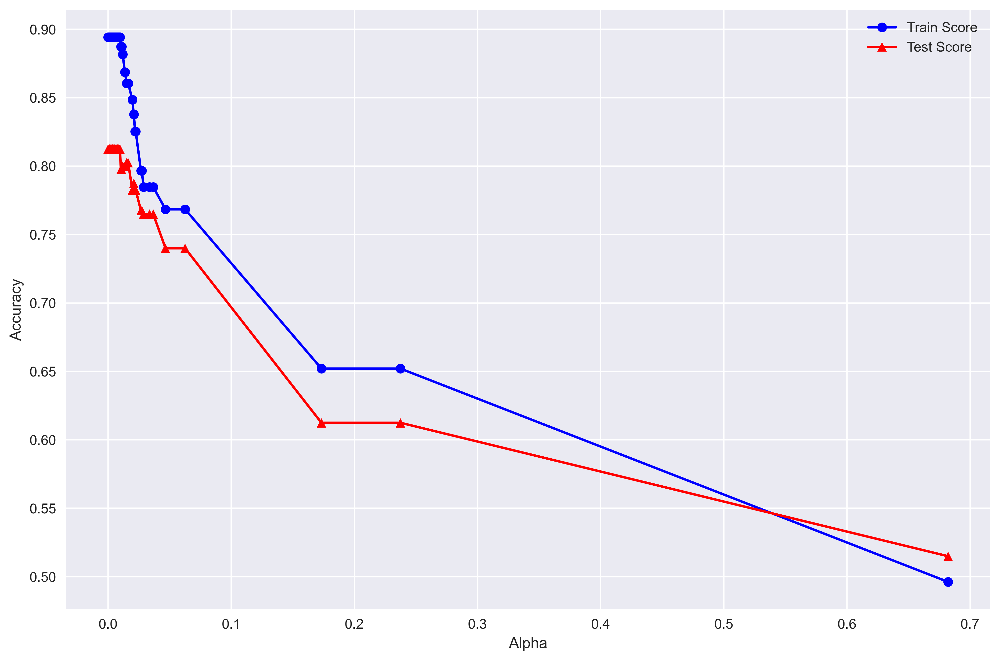

In [70]:
train_score, test_score = [], []

for alpha in path['ccp_alphas']:
    dt = dt = DecisionTreeClassifier(min_impurity_decrease = 0.01, random_state = 1, criterion = 'entropy',
                                     min_samples_leaf = 7, min_samples_split = 15, ccp_alpha = alpha)
    dt.fit(X_train, y_train)
    train_score.append(dt.score(X_train, y_train))
    test_score.append(dt.score(X_test, y_test))
    
plt.figure(figsize = (12, 8), dpi = 400)
plt.plot(path['ccp_alphas'], train_score, color = 'blue', marker = 'o', label = 'Train Score')
plt.plot(path['ccp_alphas'], test_score, color = 'red', marker = '^', label = 'Test Score')
plt.xlabel('Alpha')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

*It seems that the model's performance cannot improve changing **ccp_alpha**.*

In [71]:
dt = DecisionTreeClassifier(min_impurity_decrease = 0.008, random_state = 1, criterion = 'entropy',
                              min_samples_leaf = 9, min_samples_split = 20)

In [72]:
kfold = KFold(n_splits = 5, shuffle = True, random_state = 1)

In [73]:
cross_val_score(dt, X, y, scoring = 'accuracy', cv = kfold)

array([0.8175    , 0.85      , 0.8225    , 0.86215539, 0.84210526])

*Model is consistent throughout the train data.*

In [74]:
dt.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_impurity_decrease=0.008,
                       min_samples_leaf=9, min_samples_split=20,
                       random_state=1)

In [75]:
features_score = pd.DataFrame([X.columns, dt.feature_importances_])
features_score

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18
0,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,talk_time,three_g,touch_screen,wifi
1,0.118998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.03152,0.08696,0.762522,0.0,0.0,0.0,0.0,0.0


*Among all the features, model uses just 4 of them, and the predictive power of feature **"ram"** is arguably higher than the other features.*

In [76]:
print('Train')
print(metrics.classification_report(y_train, dt.predict(X_train)))
print('\nTest')
print(metrics.classification_report(y_test, dt.predict(X_test)))

Train
              precision    recall  f1-score   support

           0       0.94      0.94      0.94       399
           1       0.87      0.88      0.87       408
           2       0.87      0.84      0.85       397
           3       0.91      0.95      0.93       394

    accuracy                           0.90      1598
   macro avg       0.90      0.90      0.90      1598
weighted avg       0.90      0.90      0.90      1598


Test
              precision    recall  f1-score   support

           0       0.89      0.90      0.90       101
           1       0.75      0.75      0.75        91
           2       0.75      0.74      0.75       103
           3       0.87      0.88      0.87       105

    accuracy                           0.82       400
   macro avg       0.81      0.82      0.82       400
weighted avg       0.82      0.82      0.82       400



*Prediction power of the model is poorer for the class 1 and 2, and it is better for class 0 and 3.*

In [77]:
print('Train')
print(metrics.confusion_matrix(y_train, dt.predict(X_train)))
print('\nTest')
print(metrics.confusion_matrix(y_test, dt.predict(X_test)))

Train
[[377  22   0   0]
 [ 24 357  27   0]
 [  0  30 332  35]
 [  0   0  21 373]]

Test
[[91 10  0  0]
 [11 68 12  0]
 [ 0 13 76 14]
 [ 0  0 13 92]]


In [78]:
y_pred = dt.predict(X_test)
X_test['True'] = y_test
X_test['Predicted'] = y_pred

<ipython-input-78-4f314cc35c55>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['True'] = y_test
<ipython-input-78-4f314cc35c55>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['Predicted'] = y_pred


In [79]:
used_features = ['battery_power', 'px_height', 'px_width', 'ram']

<Figure size 130000x140000 with 0 Axes>

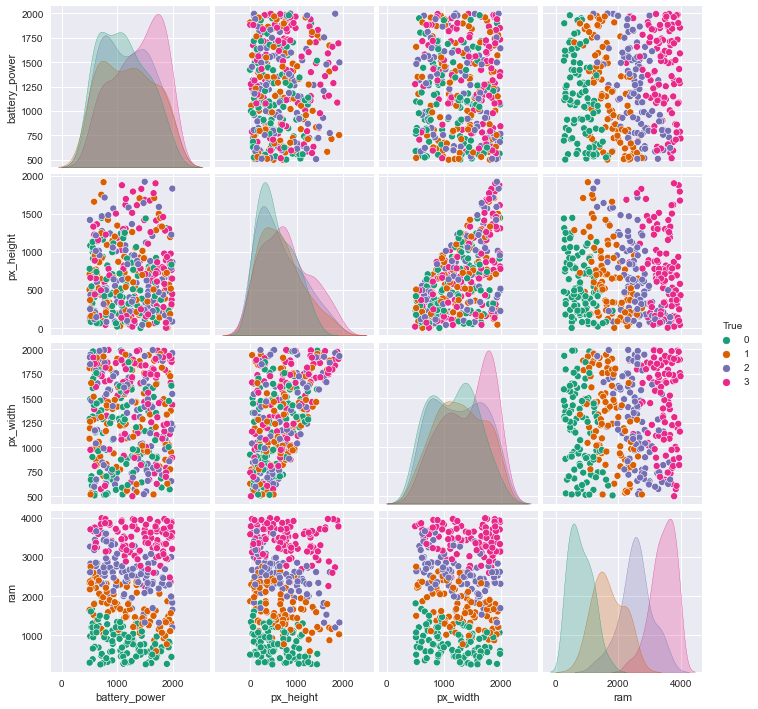

In [80]:
plt.figure(figsize = (130, 140), dpi = 1000)
sns.pairplot(X_test[used_features + ['True']] ,hue='True', palette='Dark2')
plt.show()

<Figure size 130000x140000 with 0 Axes>

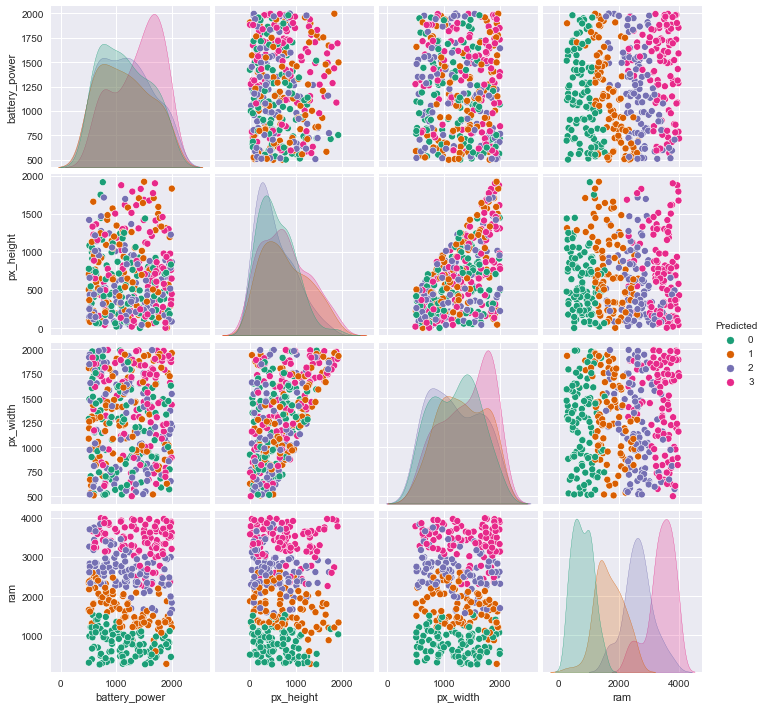

In [81]:
plt.figure(figsize = (130, 140), dpi = 1000)
sns.pairplot(X_test[used_features + ['Predicted']] ,hue='Predicted', palette='Dark2')
plt.show()

*--- Comparing pair plots above next to each other, it is obvius that the model does not have any major problem predicting classes **"0"** and **3**. But there are some misclassifications among classes **1** and **2**.*

*--- Even though this model is useful for this data, but a better performance may be achieveable using random forest algorithm.*

*--- As the final step normalizing process is being implemented to see if it results in model's improvement.*

In [82]:
X = data.drop('price_range', axis = 1)
y = data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [83]:
dt = DecisionTreeClassifier( min_impurity_decrease = 0.008, criterion = 'entropy', min_samples_leaf = 9, min_samples_split = 20)
scaler = MinMaxScaler()
pipeline = Pipeline(steps = [('s', scaler), ('m', dt)])

In [84]:
pipeline.fit(X_train, y_train)

Pipeline(steps=[('s', MinMaxScaler()),
                ('m',
                 DecisionTreeClassifier(criterion='entropy',
                                        min_impurity_decrease=0.008,
                                        min_samples_leaf=9,
                                        min_samples_split=20))])

In [85]:
print('Train')
multi_class_metrics(y_train, pipeline.predict(X_train))
print('\nTest')
multi_class_metrics(y_test, pipeline.predict(X_test))

Train
Accuracy  :  0.901
Precision :  0.901
Recall    :  0.901
f1        :  0.901

Test
Accuracy  :  0.818
Precision :  0.818
Recall    :  0.818
f1        :  0.818


*Comparing the model trained with the normalized data with the one fitted on the raw data, it can be concluded that normalization process **cannot change the model** at all!*

#### **Best Decision Tree** : 
* **Hyperparameters** : *min_impurity_decrease* = **0.008**, *criterion* = **'entropy'**, *min_samples_leaf* = **9**, *min_samples_split* = **20**
* **Accuracy** = **0.82**

### **Random Forest**

In [87]:
X = data.drop('price_range', axis = 1)
y = data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [88]:
rf = RandomForestClassifier(random_state = 1)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=1)

In [89]:
print('Train')
multi_class_metrics(y_train, rf.predict(X_train))
print('\nTest')
multi_class_metrics(y_test, rf.predict(X_test))

Train
Accuracy  :  1.0
Precision :  1.0
Recall    :  1.0
f1        :  1.0

Test
Accuracy  :  0.862
Precision :  0.862
Recall    :  0.862
f1        :  0.862


*--- It can be seen that without tuning hyperparameters, random forest reaches overfit easily.*

*--- Aiming to prune the model, methods which involve visualization are being used.*

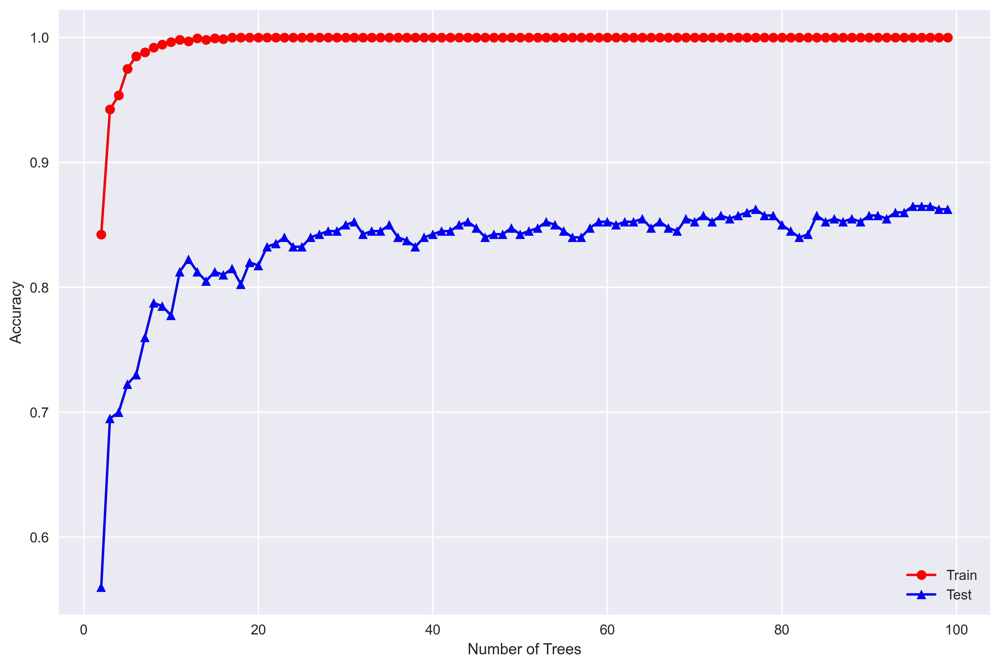

In [90]:
test_score, train_score = [], []
for n_trees in list(range(2, 100)):
    rf = RandomForestClassifier(random_state = 1, n_estimators = n_trees)
    rf.fit(X_train, y_train)
    test_score.append(rf.score(X_test, y_test))
    train_score.append(rf.score(X_train, y_train))

plt.figure(figsize = (12, 8), dpi = 400)
plt.plot(list(range(2, 100)), train_score, marker = 'o', color = 'red', label = 'Train')
plt.plot(list(range(2, 100)), test_score, marker = '^', color = 'blue', label = 'Test')
plt.xlabel('Number of Trees')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

*With increasing the number of trees to more than 17, the performance of the model on the train data reahces to 1. On the other hand, with increasing the number of trees to more than 40, the model does not show any imprvement on the test set. Considering the chart above, range of 10 to 50 is a good to start the grid search with.*

* **n_estimators** : 10 - 50

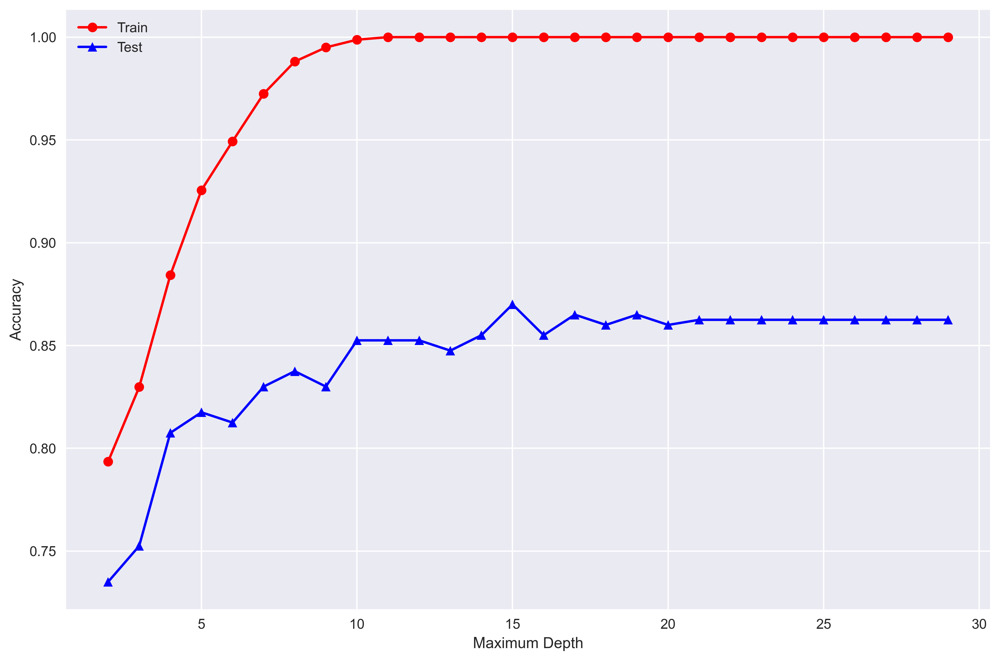

In [91]:
test_score, train_score = [], []
for depth in list(range(2, 30)):
    rf = RandomForestClassifier(random_state = 1, max_depth = depth)
    rf.fit(X_train, y_train)
    test_score.append(rf.score(X_test, y_test))
    train_score.append(rf.score(X_train, y_train))

plt.figure(figsize = (12, 8), dpi = 400)
plt.plot(list(range(2, 30)), train_score, marker = 'o', color = 'red', label = 'Train')
plt.plot(list(range(2, 30)), test_score, marker = '^', color = 'blue', label = 'Test')
plt.xlabel('Maximum Depth')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

*Maximum depth of more than 10 causes overfitting problem. However, when maximum depth is equal to 15, model shows its best performance on the test set.*

* **max_depth** : 8 - 16

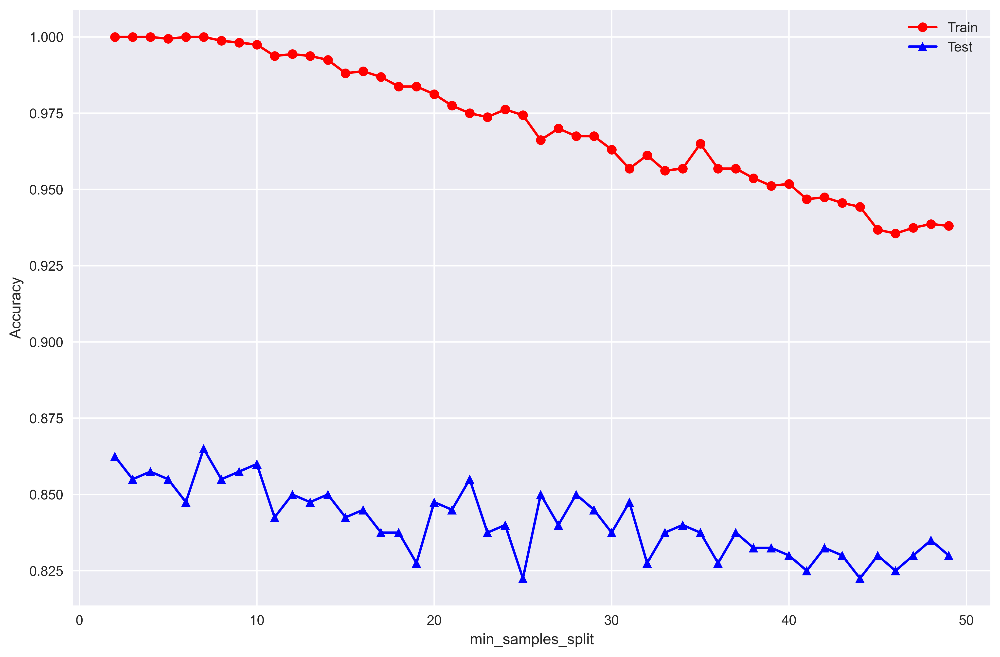

In [92]:
test_score, train_score = [], []
for n_samples in list(range(2, 50)):
    rf = RandomForestClassifier(random_state = 1, min_samples_split = n_samples)
    rf.fit(X_train, y_train)
    test_score.append(rf.score(X_test, y_test))
    train_score.append(rf.score(X_train, y_train))

plt.figure(figsize = (12, 8), dpi = 400)
plt.plot(list(range(2, 50)), train_score, marker = 'o', color = 'red', label = 'Train')
plt.plot(list(range(2, 50)), test_score, marker = '^', color = 'blue', label = 'Test')
plt.xlabel('min_samples_split')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

*With increasing min_samples_split, performance of the model on both train and test set worsens. But, the trend is steeper for the train set. As a result, higher values can prevent the model to become overfitted.*

* **min_samples_split** : 7 - 32

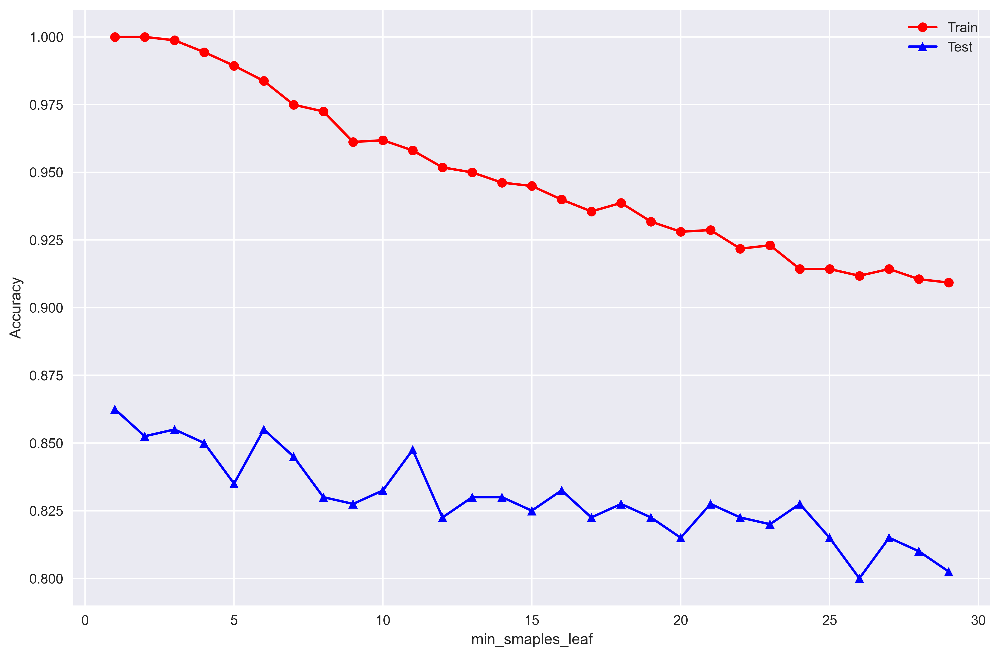

In [93]:
test_score, train_score = [], []
for n_samples in list(range(1, 30)):
    rf = RandomForestClassifier(random_state = 1, min_samples_leaf = n_samples)
    rf.fit(X_train, y_train)
    test_score.append(rf.score(X_test, y_test))
    train_score.append(rf.score(X_train, y_train))

plt.figure(figsize = (12, 8), dpi = 400)
plt.plot(list(range(1, 30)), train_score, marker = 'o', color = 'red', label = 'Train')
plt.plot(list(range(1, 30)), test_score, marker = '^', color = 'blue', label = 'Test')
plt.xlabel('min_smaples_leaf')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

*Just like min_smaples_split, min_samples_leaf has the very same effect on train and test set. Values more than 11, decrease the accuracy on the test set, and values more than 5, wrosens the performance on the train set.*

* **min_samples_leaf** : 3 - 15

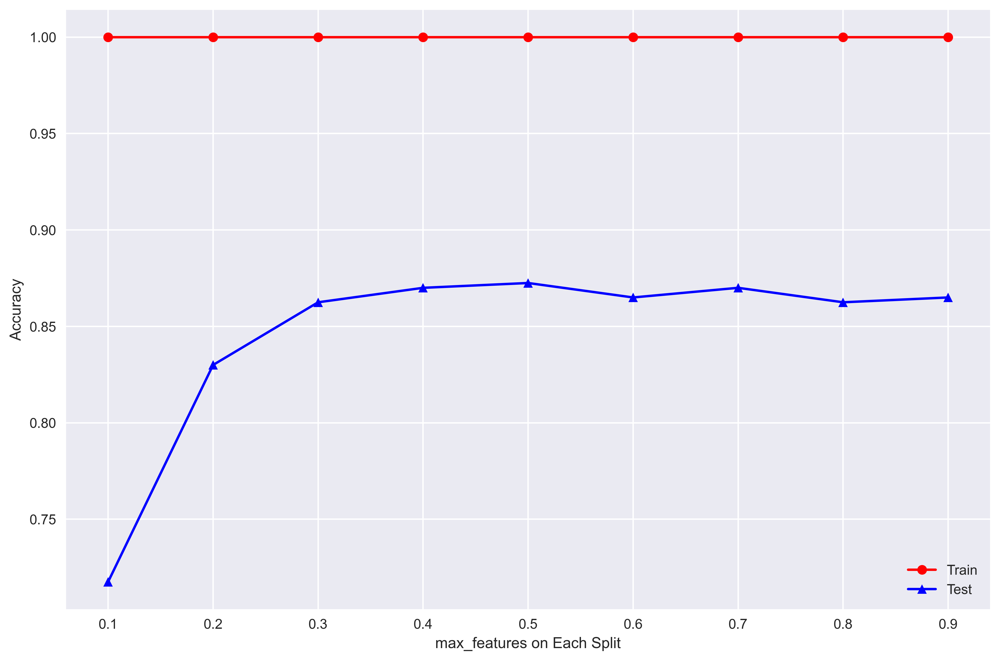

In [94]:
test_score, train_score = [], []
for n_features in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]:
    rf = RandomForestClassifier(random_state = 1, max_features = n_features)
    rf.fit(X_train, y_train)
    test_score.append(rf.score(X_test, y_test))
    train_score.append(rf.score(X_train, y_train))

plt.figure(figsize = (12, 8), dpi = 400)
plt.plot([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9], train_score, marker = 'o', color = 'red', label = 'Train')
plt.plot([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9], test_score, marker = '^', color = 'blue', label = 'Test')
plt.xlabel('max_features on Each Split')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

*Lower numbers for max_features, is not good, as the accuracy on the test set is significantly low. However, values more than 0.3, does not improve the model regarding the test set.*

* **max_features** : 0.3 - 1

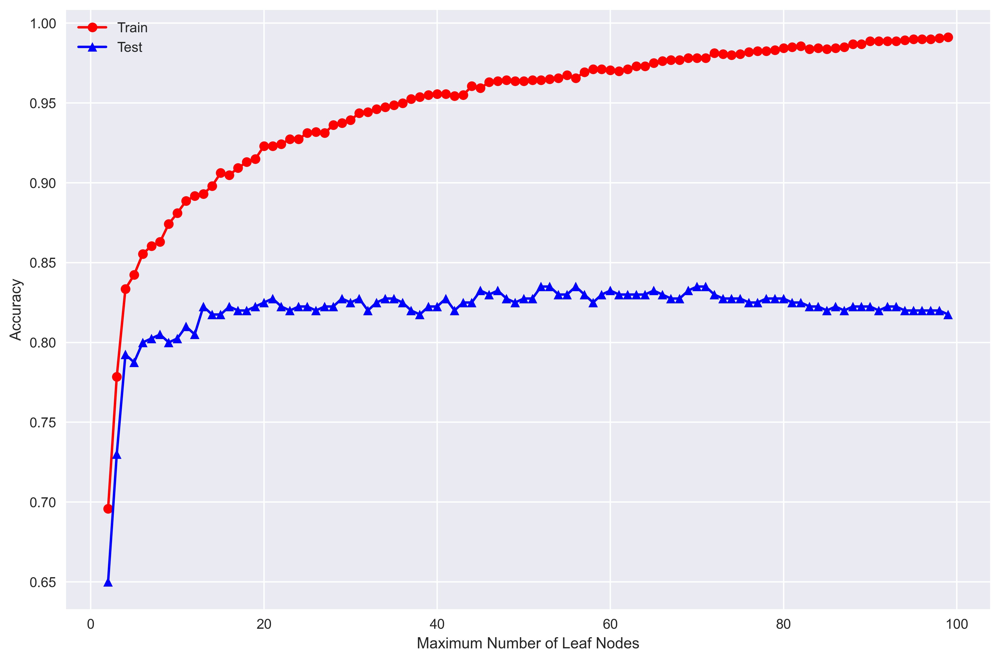

In [95]:
test_score, train_score = [], []
for n_leaves in list(range(2, 100)):
    rf = RandomForestClassifier(random_state = 1, max_leaf_nodes = n_leaves)
    rf.fit(X_train, y_train)
    test_score.append(rf.score(X_test, y_test))
    train_score.append(rf.score(X_train, y_train))

plt.figure(figsize = (12, 8), dpi = 400)
plt.plot(list(range(2, 100)), train_score, marker = 'o', color = 'red', label = 'Train')
plt.plot(list(range(2, 100)), test_score, marker = '^', color = 'blue', label = 'Test')
plt.xlabel('Maximum Number of Leaf Nodes')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

* It can be seen that restricting the maximum number of leaf nodes, prevents the model from being overfitted.*

* **max_leaf_nodes** : 20 - 80

In [96]:
# For deacreasing computational complexity, bigger grids are being tested. Also, only the hyper parameters 
# above are given to the model to find the optimum range.

params = {'n_estimators' : list(range(10, 51, 10)), 'max_depth' : list(range(8, 17, 2)),
          'min_samples_split' : list(range(7, 36, 7)), 'min_samples_leaf' : list(range(3, 16, 3)),
          'max_features' : [0.3, 0.5, 0.7, 0.9], 'max_leaf_nodes' : list(range(20, 81, 10))}

In [97]:
rf = RandomForestClassifier(random_state = 1)
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(rf, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [98]:
X, y = data.drop('price_range', axis = 1), data['price_range']
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=RandomForestClassifier(random_state=1), n_jobs=-1,
             param_grid={'max_depth': [8, 10, 12, 14, 16],
                         'max_features': [0.3, 0.5, 0.7, 0.9],
                         'max_leaf_nodes': [20, 30, 40, 50, 60, 70, 80],
                         'min_samples_leaf': [3, 6, 9, 12, 15],
                         'min_samples_split': [7, 14, 21, 28, 35],
                         'n_estimators': [10, 20, 30, 40, 50]},
             return_train_score=True, scoring='accuracy')

In [99]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_max_features,param_max_leaf_nodes,param_min_samples_leaf,param_min_samples_split,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
9504,0.402124,0.003362,0.013764,0.000399,12,0.7,80,3,7,50,"{'max_depth': 12, 'max_features': 0.7, 'max_le...",0.8675,0.9075,0.9100,0.932331,0.889724,0.901411,0.021695,1,0.983730,0.980601,0.988110,0.986867,0.986241,0.985110,0.002669
16504,0.408706,0.006257,0.014963,0.000892,16,0.7,80,3,7,50,"{'max_depth': 16, 'max_features': 0.7, 'max_le...",0.8675,0.9075,0.9100,0.932331,0.889724,0.901411,0.021695,1,0.983730,0.981227,0.988110,0.986867,0.986241,0.985235,0.002461
13004,0.412894,0.002745,0.014962,0.000631,14,0.7,80,3,7,50,"{'max_depth': 14, 'max_features': 0.7, 'max_le...",0.8675,0.9075,0.9100,0.932331,0.889724,0.901411,0.021695,1,0.983730,0.981227,0.988110,0.986867,0.986241,0.985235,0.002461
9379,0.397337,0.006004,0.013964,0.000630,12,0.7,70,3,7,50,"{'max_depth': 12, 'max_features': 0.7, 'max_le...",0.8675,0.9025,0.9125,0.929825,0.892231,0.900911,0.020806,4,0.979349,0.975594,0.984355,0.980613,0.980613,0.980105,0.002811
16379,0.406512,0.004165,0.014363,0.000799,16,0.7,70,3,7,50,"{'max_depth': 16, 'max_features': 0.7, 'max_le...",0.8675,0.9025,0.9125,0.929825,0.892231,0.900911,0.020806,4,0.979349,0.975594,0.984355,0.980613,0.980613,0.980105,0.002811
12879,0.401923,0.008577,0.013165,0.000399,14,0.7,70,3,7,50,"{'max_depth': 14, 'max_features': 0.7, 'max_le...",0.8675,0.9025,0.9125,0.929825,0.892231,0.900911,0.020806,4,0.979349,0.975594,0.984355,0.980613,0.980613,0.980105,0.002811
5879,0.401726,0.003179,0.014760,0.001828,10,0.7,70,3,7,50,"{'max_depth': 10, 'max_features': 0.7, 'max_le...",0.8650,0.9050,0.9125,0.927318,0.889724,0.899909,0.021251,7,0.979975,0.977472,0.984981,0.979987,0.981864,0.980856,0.002491
5128,0.270874,0.006693,0.012168,0.000400,10,0.5,80,3,7,40,"{'max_depth': 10, 'max_features': 0.5, 'max_le...",0.8625,0.9075,0.9150,0.924812,0.889724,0.899907,0.021949,8,0.981852,0.978098,0.981852,0.979362,0.986867,0.981606,0.003005
6004,0.413094,0.005215,0.014761,0.001162,10,0.7,80,3,7,50,"{'max_depth': 10, 'max_features': 0.7, 'max_le...",0.8625,0.9050,0.9100,0.929825,0.889724,0.899410,0.022470,9,0.981227,0.982478,0.987484,0.986241,0.985616,0.984609,0.002363
13003,0.332113,0.006700,0.011567,0.000492,14,0.7,80,3,7,40,"{'max_depth': 14, 'max_features': 0.7, 'max_le...",0.8650,0.9050,0.9100,0.929825,0.887218,0.899409,0.021914,10,0.981852,0.980601,0.984981,0.983740,0.986241,0.983483,0.002044


*Now, the hyperparameters above are going through grid search process with norrowed down ranges.*

* **max_depth** : 11 - 17
* **max_features** : 0.6 - 0.8
* **max_leaf_nodes** : 70 - 80
* **min_samples_leaf** : 2 - 4
* **min_samples_split** : 6 - 8
* **n_estimators** : 45 - 55

In [100]:
params = {'n_estimators' : [45, 50, 55], 'max_depth' : list(range(11, 18, 2)),
          'min_samples_split' : [6, 7, 8], 'min_samples_leaf' : [2, 3, 4],
          'max_features' : [0.6, 0.7, 0.8], 'max_leaf_nodes' : list(range(70, 81, 2))}

In [101]:
rf = RandomForestClassifier(random_state = 1)
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(rf, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [103]:
X, y = data.drop('price_range', axis = 1), data['price_range']
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=RandomForestClassifier(random_state=1), n_jobs=-1,
             param_grid={'max_depth': [11, 13, 15, 17],
                         'max_features': [0.6, 0.7, 0.8],
                         'max_leaf_nodes': [70, 72, 74, 76, 78, 80],
                         'min_samples_leaf': [2, 3, 4],
                         'min_samples_split': [6, 7, 8],
                         'n_estimators': [45, 50, 55]},
             return_train_score=True, scoring='accuracy')

In [104]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_max_features,param_max_leaf_nodes,param_min_samples_leaf,param_min_samples_split,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
1146,0.350022,0.001559,0.012166,0.006117,15,0.7,70,3,7,45,"{'max_depth': 15, 'max_features': 0.7, 'max_le...",0.8725,0.9050,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
660,0.359904,0.006470,0.008248,0.006216,13,0.7,70,3,7,45,"{'max_depth': 13, 'max_features': 0.7, 'max_le...",0.8725,0.9050,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
1632,0.351053,0.010440,0.008309,0.006853,17,0.7,70,3,7,45,"{'max_depth': 17, 'max_features': 0.7, 'max_le...",0.8725,0.9050,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
229,0.410683,0.005800,0.014161,0.001467,11,0.7,74,3,7,50,"{'max_depth': 11, 'max_features': 0.7, 'max_le...",0.8675,0.9050,0.9100,0.932331,0.892231,0.901412,0.021340,4,0.981852,0.978723,0.986233,0.984365,0.983740,0.982983,0.002548
1200,0.367213,0.006067,0.013363,0.000798,15,0.7,74,3,7,45,"{'max_depth': 15, 'max_features': 0.7, 'max_le...",0.8700,0.9050,0.9100,0.932331,0.889724,0.901411,0.020813,5,0.981227,0.979349,0.985607,0.981864,0.983740,0.982357,0.002147
796,0.401205,0.005531,0.011966,0.006071,13,0.7,80,3,7,50,"{'max_depth': 13, 'max_features': 0.7, 'max_le...",0.8675,0.9075,0.9100,0.932331,0.889724,0.901411,0.021695,5,0.983730,0.981227,0.988110,0.986867,0.986241,0.985235,0.002461
1686,0.366218,0.004158,0.012966,0.000892,17,0.7,74,3,7,45,"{'max_depth': 17, 'max_features': 0.7, 'max_le...",0.8700,0.9050,0.9100,0.932331,0.889724,0.901411,0.020813,5,0.981227,0.979349,0.985607,0.981864,0.983740,0.982357,0.002147
202,0.415691,0.003304,0.014160,0.000744,11,0.7,72,3,7,50,"{'max_depth': 11, 'max_features': 0.7, 'max_le...",0.8675,0.9050,0.9125,0.929825,0.892231,0.901411,0.020868,5,0.979349,0.978723,0.986233,0.982489,0.983114,0.981982,0.002726
1768,0.412619,0.005880,0.013962,0.000630,17,0.7,80,3,7,50,"{'max_depth': 17, 'max_features': 0.7, 'max_le...",0.8675,0.9075,0.9100,0.932331,0.889724,0.901411,0.021695,5,0.983730,0.981227,0.988110,0.986867,0.986241,0.985235,0.002461
310,0.411902,0.003563,0.013761,0.000749,11,0.7,80,3,7,50,"{'max_depth': 11, 'max_features': 0.7, 'max_le...",0.8675,0.9075,0.9100,0.932331,0.889724,0.901411,0.021695,5,0.983104,0.981227,0.988110,0.986867,0.986241,0.985110,0.002548


*--- Analysing the results above, the best 3 models are less prone to overfitting as their hyperparameters are more restricting. This can be confrimed by comparing the mean_train_score of different models with the mean_test_score.*

*--- It can be seen that in the best models, some of the hyperparameters are excatly the same as the previous search. By keeping those hyperparameters, new ones and the ones that did not show consistent effect are going through the process again.*

* **min_samples_split** : 7
* **min_samples_leaf** : 3
* **max_features** : 0.7
* **max_depth** : 14 - 18
* **max_leaf_nodes** : 68 - 72
* **n_estimators** : 45 - 50

In [105]:
params = {'n_estimators' : [45, 47, 50], 'max_depth' : [14, 15, 16, 17, 18],
          'max_leaf_nodes' : [68, 70, 72]}

In [106]:
rf = RandomForestClassifier(random_state = 1, min_samples_split = 7, min_samples_leaf = 3, max_features = 0.7)
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(rf, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [107]:
X, y = data.drop('price_range', axis = 1), data['price_range']
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=RandomForestClassifier(max_features=0.7,
                                              min_samples_leaf=3,
                                              min_samples_split=7,
                                              random_state=1),
             n_jobs=-1,
             param_grid={'max_depth': [14, 15, 16, 17, 18],
                         'max_leaf_nodes': [68, 70, 72],
                         'n_estimators': [45, 47, 50]},
             return_train_score=True, scoring='accuracy')

In [108]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_max_leaf_nodes,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
21,0.366218,0.005405,0.013165,3.993514e-04,16,70,45,"{'max_depth': 16, 'max_leaf_nodes': 70, 'n_est...",0.8725,0.905,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
3,0.371186,0.005449,0.014162,1.933404e-03,14,70,45,"{'max_depth': 14, 'max_leaf_nodes': 70, 'n_est...",0.8725,0.905,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
30,0.368542,0.014265,0.012432,6.224247e-03,17,70,45,"{'max_depth': 17, 'max_leaf_nodes': 70, 'n_est...",0.8725,0.905,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
12,0.366019,0.004886,0.013770,7.418959e-04,15,70,45,"{'max_depth': 15, 'max_leaf_nodes': 70, 'n_est...",0.8725,0.905,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
39,0.359766,0.009271,0.013362,4.903541e-04,18,70,45,"{'max_depth': 18, 'max_leaf_nodes': 70, 'n_est...",0.8725,0.905,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
9,0.357438,0.011492,0.014692,1.416652e-03,15,68,45,"{'max_depth': 15, 'max_leaf_nodes': 68, 'n_est...",0.8725,0.905,0.9075,0.932331,0.889724,0.901411,0.019892,6,0.979349,0.975594,0.981852,0.978737,0.979362,0.978979,0.002003
18,0.369212,0.007913,0.013563,4.894927e-04,16,68,45,"{'max_depth': 16, 'max_leaf_nodes': 68, 'n_est...",0.8725,0.905,0.9075,0.932331,0.889724,0.901411,0.019892,6,0.979349,0.975594,0.981852,0.978737,0.979362,0.978979,0.002003
27,0.382977,0.023575,0.016156,2.033808e-03,17,68,45,"{'max_depth': 17, 'max_leaf_nodes': 68, 'n_est...",0.8725,0.905,0.9075,0.932331,0.889724,0.901411,0.019892,6,0.979349,0.975594,0.981852,0.978737,0.979362,0.978979,0.002003
0,0.354001,0.005049,0.015622,6.975526e-07,14,68,45,"{'max_depth': 14, 'max_leaf_nodes': 68, 'n_est...",0.8725,0.905,0.9075,0.932331,0.889724,0.901411,0.019892,6,0.979349,0.975594,0.981852,0.978737,0.979362,0.978979,0.002003
36,0.364027,0.005163,0.013963,8.912707e-04,18,68,45,"{'max_depth': 18, 'max_leaf_nodes': 68, 'n_est...",0.8725,0.905,0.9075,0.932331,0.889724,0.901411,0.019892,6,0.979349,0.975594,0.981852,0.978737,0.979362,0.978979,0.002003


*--- Considering that the best models performed equally, the most restrictive model is the best one.*

*--- As the tuned values of the hyperparameters has been obtained, two binary hyperparameters are being checked to find the best model.*

* **criterion** : gini, entropy
* **oob_score** : False, True

In [109]:
params = {'criterion' : ['gini', 'entropy'], 'oob_score' : [False, True]}

In [110]:
rf = RandomForestClassifier(random_state = 1, min_samples_split = 7, min_samples_leaf = 3,
                            max_features = 0.7, max_depth = 14, max_leaf_nodes = 70, n_estimators = 45)
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(rf, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [111]:
X, y = data.drop('price_range', axis = 1), data['price_range']
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=RandomForestClassifier(max_depth=14, max_features=0.7,
                                              max_leaf_nodes=70,
                                              min_samples_leaf=3,
                                              min_samples_split=7,
                                              n_estimators=45, random_state=1),
             n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'oob_score': [False, True]},
             return_train_score=True, scoring='accuracy')

In [112]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_oob_score,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.362294,0.024433,0.019794,0.005495,gini,False,"{'criterion': 'gini', 'oob_score': False}",0.8725,0.9050,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
1,0.405427,0.017140,0.013564,0.001017,gini,True,"{'criterion': 'gini', 'oob_score': True}",0.8725,0.9050,0.9100,0.932331,0.892231,0.902412,0.019788,1,0.980601,0.978098,0.983104,0.980613,0.980613,0.980606,0.001583
2,0.498067,0.004488,0.012368,0.001352,entropy,False,"{'criterion': 'entropy', 'oob_score': False}",0.8750,0.9075,0.9075,0.912281,0.907268,0.901910,0.013586,3,0.989987,0.986859,0.991865,0.984991,0.988118,0.988364,0.002392
3,0.439025,0.043851,0.009375,0.002149,entropy,True,"{'criterion': 'entropy', 'oob_score': True}",0.8750,0.9075,0.9075,0.912281,0.907268,0.901910,0.013586,3,0.989987,0.986859,0.991865,0.984991,0.988118,0.988364,0.002392


*It seems that the default values are better for these parameters.*

In [113]:
X, y = data.drop('price_range', axis = 1), data['price_range']

In [114]:
rf = RandomForestClassifier(random_state = 1, min_samples_split = 7, min_samples_leaf = 3, n_jobs = -1,
                            max_features = 0.7, max_depth = 14, max_leaf_nodes = 70, n_estimators = 45)

In [115]:
kfold = KFold(5, shuffle = True, random_state = 1)
cross_val_score(rf, X, y, scoring = 'accuracy', cv = kfold)

array([0.8725    , 0.905     , 0.91      , 0.93233083, 0.89223058])

*Consistency of the model is acceptable.*

In [116]:
X, y = data.drop('price_range', axis = 1), data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [117]:
rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=14, max_features=0.7, max_leaf_nodes=70,
                       min_samples_leaf=3, min_samples_split=7, n_estimators=45,
                       n_jobs=-1, random_state=1)

In [118]:
print('Train')
multi_class_metrics(y_train, rf.predict(X_train))
print('\nTest')
multi_class_metrics(y_test, rf.predict(X_test))

Train
Accuracy  :  0.978
Precision :  0.978
Recall    :  0.978
f1        :  0.978

Test
Accuracy  :  0.87
Precision :  0.87
Recall    :  0.87
f1        :  0.87


In [119]:
print('Train')
print(metrics.classification_report(y_train, rf.predict(X_train)))
print('\nTest')
print(metrics.classification_report(y_test, rf.predict(X_test)))

Train
              precision    recall  f1-score   support

           0       0.99      0.98      0.98       399
           1       0.95      0.98      0.97       408
           2       0.99      0.96      0.97       397
           3       0.98      0.99      0.99       394

    accuracy                           0.98      1598
   macro avg       0.98      0.98      0.98      1598
weighted avg       0.98      0.98      0.98      1598


Test
              precision    recall  f1-score   support

           0       0.92      0.94      0.93       101
           1       0.80      0.86      0.83        91
           2       0.83      0.80      0.81       103
           3       0.92      0.89      0.90       105

    accuracy                           0.87       400
   macro avg       0.87      0.87      0.87       400
weighted avg       0.87      0.87      0.87       400



*Comparing with the best decision tree model, random forest performed much better. The only similarity between these two is the prediction power of models among classes. It seems that distiguishing classes **1** and **2** are harder than **0** and **3**.*

In [120]:
print('Train')
print(metrics.confusion_matrix(y_train, rf.predict(X_train)))
print('\nTest')
print(metrics.confusion_matrix(y_test, rf.predict(X_test)))

Train
[[390   9   0   0]
 [  5 401   2   0]
 [  0  10 381   6]
 [  0   0   3 391]]

Test
[[95  6  0  0]
 [ 8 78  5  0]
 [ 0 13 82  8]
 [ 0  0 12 93]]


*Inspecting the matrix, it can be seen that the classes can be misclassified just with a neighbor class.* 

In [121]:
X_test['Predicted'] = rf.predict(X_test)
X_test['True'] = y_test

<ipython-input-121-198f01aa0b65>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['Predicted'] = rf.predict(X_test)
<ipython-input-121-198f01aa0b65>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['True'] = y_test


<Figure size 130000x140000 with 0 Axes>

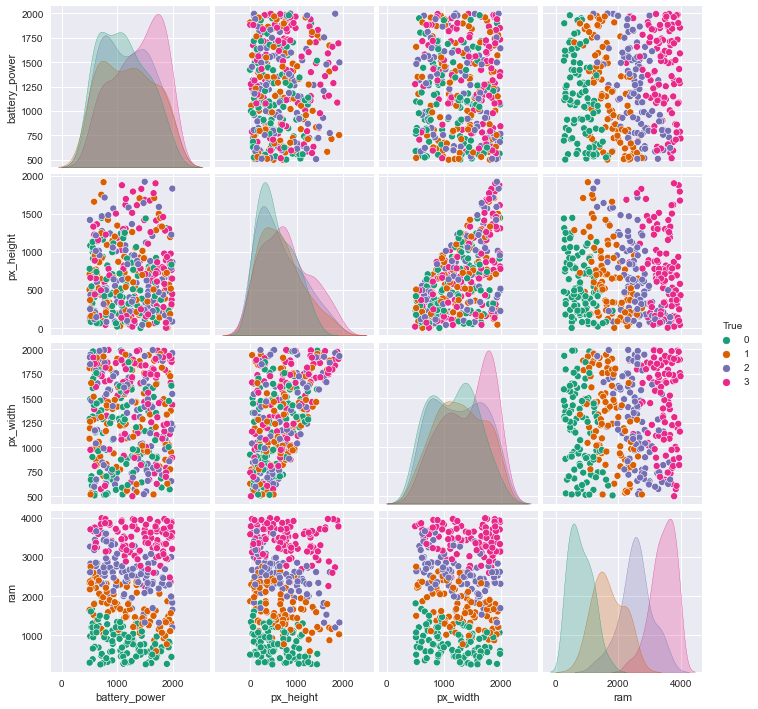

In [122]:
plt.figure(figsize = (130, 140), dpi = 1000)
sns.pairplot(X_test[used_features + ['True']] ,hue='True', palette='Dark2')
plt.show()

<Figure size 130000x140000 with 0 Axes>

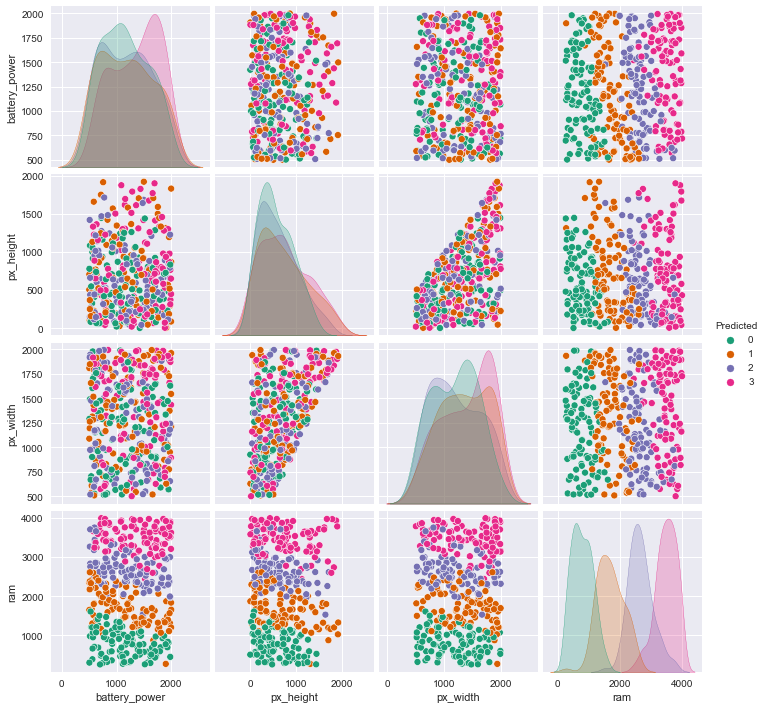

In [123]:
plt.figure(figsize = (130, 140), dpi = 1000)
sns.pairplot(X_test[used_features + ['Predicted']] ,hue='Predicted', palette='Dark2')
plt.show()

*The misclassification cases are mostly the samples which are really harder to separate from another class, like border lines between classes and initially misclassified ones.*

*As it was checked on the decision tree, normalizing is not helpful in these algorithms.*

#### **Best Random Forest** : 
* **Hyperparameters** : **min_samples_split** = 7, **min_samples_leaf** = 3, **max_features** = 0.7, **max_depth** = 14, **max_leaf_nodes** = 70, **n_estimators** = 45
* **Accuracy** = **0.87**

### **Support Vector Machine**

In [124]:
X = data.drop('price_range', axis = 1)
y = data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [126]:
svm = SVC(random_state = 1)
svm.fit(X_train, y_train)

SVC(random_state=1)

In [127]:
print('Train')
multi_class_metrics(y_train, svm.predict(X_train))
print('\nTest')
multi_class_metrics(y_test, svm.predict(X_test))

Train
Accuracy  :  0.949
Precision :  0.949
Recall    :  0.949
f1        :  0.949

Test
Accuracy  :  0.948
Precision :  0.948
Recall    :  0.948
f1        :  0.948


*Comparing the results with those of previous algorithms, SVM is far **less prone to overfitting**. Also, **initial resualts are much better** than its counterparts, so tuning the hyperparameters parobably gives the best model for this dataset.*

In [128]:
params = {'kernel' : ['linear', 'poly', 'rbf', 'sigmoid']}

In [129]:
svm = SVC(random_state = 1)
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(svm, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [130]:
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=SVC(random_state=1), n_jobs=-1,
             param_grid={'kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             return_train_score=True, scoring='accuracy')

In [131]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,12.164788,1.763714,0.002394,0.001353,linear,{'kernel': 'linear'},0.9750,0.9650,0.9650,0.987469,0.972431,0.972980,0.008266,1,0.989987,0.991239,0.993116,0.984991,0.994371,0.990741,0.003247
1,0.037810,0.003576,0.015157,0.000649,poly,{'kernel': 'poly'},0.9675,0.9500,0.9425,0.962406,0.944862,0.953454,0.009830,2,0.955569,0.957447,0.966208,0.960600,0.958724,0.959710,0.003640
2,0.065356,0.002455,0.066423,0.001017,rbf,{'kernel': 'rbf'},0.9475,0.9400,0.9400,0.964912,0.954887,0.949460,0.009498,3,0.949312,0.950563,0.954944,0.956223,0.952470,0.952702,0.002590
3,0.264087,0.009285,0.053283,0.004269,sigmoid,{'kernel': 'sigmoid'},0.1800,0.1625,0.1625,0.203008,0.162907,0.174183,0.015905,4,0.188360,0.179599,0.183980,0.180113,0.169481,0.180307,0.006262


*--- Based on the results above, **sigmoid** is **not an appropriate kernel** for this problem. The rest of the kernels' performances are the same to some extent.*

*--- Another problem here is that despite the good performance of **"linear"** kernel, it takes qiute a lot of time to be trained on the data, so using it may not be computationaly efficient.*

*--- Comparing mean_test_score with mean_train_score, **"linear"** kernel is **more prone** to overfitting, and it should not be neglected.*

*--- Now hyperparameters **"C"** and **"decision_function_shape"**, along **"kernel"**, are going through grid search process.* 

In [132]:
params = {'kernel' : ['linear', 'poly', 'rbf'], 'C' : [0.1, 1, 10, 100, 1000], 'decision_function_shape' : 
         ['ovo', 'ovr']}

In [133]:
svm = SVC(random_state = 1)
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(svm, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [134]:
X, y = data.drop('price_range', axis = 1), data['price_range']
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=SVC(random_state=1), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'decision_function_shape': ['ovo', 'ovr'],
                         'kernel': ['linear', 'poly', 'rbf']},
             return_train_score=True, scoring='accuracy')

In [135]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_decision_function_shape,param_kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,3.326301,1.061250,0.005186,0.000399,0.1,ovo,linear,"{'C': 0.1, 'decision_function_shape': 'ovo', '...",0.9750,0.9725,0.9700,0.987469,0.967419,0.974477,0.006969,1,0.987484,0.991865,0.989987,0.984365,0.990619,0.988864,0.002664
3,3.372876,1.079734,0.005585,0.000489,0.1,ovr,linear,"{'C': 0.1, 'decision_function_shape': 'ovr', '...",0.9750,0.9725,0.9700,0.987469,0.967419,0.974477,0.006969,1,0.987484,0.991865,0.989987,0.984365,0.990619,0.988864,0.002664
6,17.208425,3.572757,0.004588,0.000488,1,ovo,linear,"{'C': 1, 'decision_function_shape': 'ovo', 'ke...",0.9750,0.9650,0.9650,0.987469,0.972431,0.972980,0.008266,3,0.989987,0.991239,0.993116,0.984991,0.994371,0.990741,0.003247
9,17.329845,3.574443,0.006914,0.004371,1,ovr,linear,"{'C': 1, 'decision_function_shape': 'ovr', 'ke...",0.9750,0.9650,0.9650,0.987469,0.972431,0.972980,0.008266,3,0.989987,0.991239,0.993116,0.984991,0.994371,0.990741,0.003247
26,0.046090,0.001699,0.014960,0.000630,1000,ovo,rbf,"{'C': 1000, 'decision_function_shape': 'ovo', ...",0.9775,0.9725,0.9575,0.974937,0.972431,0.970974,0.006990,5,0.989362,0.989987,0.987484,0.984991,0.989368,0.988239,0.001828
29,0.050663,0.004694,0.015958,0.001093,1000,ovr,rbf,"{'C': 1000, 'decision_function_shape': 'ovr', ...",0.9775,0.9725,0.9575,0.974937,0.972431,0.970974,0.006990,5,0.989362,0.989987,0.987484,0.984991,0.989368,0.988239,0.001828
18,48.865731,15.537402,0.003591,0.001850,100,ovo,linear,"{'C': 100, 'decision_function_shape': 'ovo', '...",0.9725,0.9625,0.9675,0.984962,0.962406,0.969974,0.008370,7,0.981852,0.989362,0.988736,0.983114,0.992495,0.987112,0.004008
27,48.940946,11.200956,0.006305,0.004867,1000,ovr,linear,"{'C': 1000, 'decision_function_shape': 'ovr', ...",0.9725,0.9625,0.9675,0.984962,0.962406,0.969974,0.008370,7,0.982478,0.989362,0.988736,0.983114,0.991870,0.987112,0.003682
24,55.774738,15.850579,0.006514,0.004614,1000,ovo,linear,"{'C': 1000, 'decision_function_shape': 'ovo', ...",0.9725,0.9625,0.9675,0.984962,0.962406,0.969974,0.008370,7,0.982478,0.989362,0.988736,0.983114,0.991870,0.987112,0.003682
21,49.042712,15.458975,0.004588,0.000489,100,ovr,linear,"{'C': 100, 'decision_function_shape': 'ovr', '...",0.9725,0.9625,0.9675,0.984962,0.962406,0.969974,0.008370,7,0.981852,0.989362,0.988736,0.983114,0.992495,0.987112,0.004008


*--- Best performance achieved by **"linear"** kernel. Also, mean_fit_time of the best 2 models are far less than other models using "linear" kernel. It seems that the time efficiency is the result of lower **"C"** value.*

*--- The best 2 models are also not as near as the 3rd and 4th model to the overfit state.*

*--- With higher **"C"** values, **"rbf"** performed better than the other kernels.*

*--- High values of **"C"**, cause the hyperparameter to lose its effect when it is used with **"linear"** kernel.*

*--- Note that there is no difference between **one Vs rest** and **one Vs one** methods, other than the training time.*

*--- Kernel **"poly"** could not compete with its counterparts. However, it is known that the "poly" kernel works better with normalized data, so an extra loop is beign run to check if polynomial kernel can yield a competetive result.*

In [136]:
for c in [0.1, 1, 10, 100, 1000]:
    svm = SVC(random_state = 1, kernel = 'poly', C = c)
    scaler = MinMaxScaler()
    pipeline = Pipeline(steps = [('s', scaler), ('m', svm)])
    kfold = KFold(n_splits = 5, shuffle = True, random_state = 1)
    print(c)
    print(cross_val_score(pipeline, X, y, cv = kfold))
    print(np.mean(cross_val_score(pipeline, X, y, cv = kfold)))
    print('\n')

0.1
[0.8625     0.8575     0.86       0.86716792 0.86466165]
0.8623659147869673


1
[0.8675     0.8875     0.865      0.89724311 0.90726817]
0.8849022556390977


10
[0.86       0.87       0.8475     0.88220551 0.87218045]
0.8663771929824561


100
[0.8525     0.87       0.8475     0.88220551 0.87218045]
0.8648771929824562


1000
[0.8525     0.87       0.8475     0.88220551 0.87218045]
0.8648771929824562




*Seems that higher values of "C" does not have any effect on the model.*

In [137]:
for c in [0.1, 1, 10]:
    for degree in [1, 2, 3]:
        svm = SVC(random_state = 1, kernel = 'poly', C = c, degree = degree)
        scaler = MinMaxScaler()
        pipeline = Pipeline(steps = [('s', scaler), ('m', svm)])
        kfold = KFold(n_splits = 5, shuffle = True, random_state = 1)
        print(f'C = {c} / degree = {degree}')
        print(cross_val_score(pipeline, X, y, cv = kfold))
        print(np.mean(cross_val_score(pipeline, X, y, cv = kfold)))
        print('\n')

C = 0.1 / degree = 1
[0.76       0.81       0.82       0.78195489 0.78195489]
0.790781954887218


C = 0.1 / degree = 2
[0.8925     0.895      0.8775     0.88471178 0.89223058]
0.8883884711779448


C = 0.1 / degree = 3
[0.8625     0.8575     0.86       0.86716792 0.86466165]
0.8623659147869673


C = 1 / degree = 1
[0.925      0.9325     0.9275     0.95739348 0.93734336]
0.9359473684210526


C = 1 / degree = 2
[0.925      0.8875     0.88       0.90225564 0.92982456]
0.9049160401002506


C = 1 / degree = 3
[0.8675     0.8875     0.865      0.89724311 0.90726817]
0.8849022556390977


C = 10 / degree = 1
[0.965      0.945      0.94       0.96240602 0.95488722]
0.9534586466165413


C = 10 / degree = 2
[0.925     0.885     0.8875    0.9122807 0.9047619]
0.9029085213032582


C = 10 / degree = 3
[0.86       0.87       0.8475     0.88220551 0.87218045]
0.8663771929824561




*Analyzing the results above, polynomial kernel of degree 1, which is perform almost like linear kernel, has the best results. So, polynomial kernel is getting out of the list.*

*Now as we only work with "linear" and "rbf" kernel, there are not many hyperparameters left to be tuned. Parameter **"C"** still need to tuned for a better possible performance. Parameter **"gamma"** is only need to be tuned for the "rbf" kernel. Also, **"shriniking"** optimization can only lead to an efficient run time, but it does not have any effect on the metrics. Last but not least, optimizing **"break_ties"** might help with obtaining better results.*

In [138]:
# Shrinking is not defined beceaus of the time inefficiency of linear kernel.

params = {'C' : [0.05, 0.1, 0.5, 1], 'decision_function_shape' : ['ovo', 'ovr']}

In [139]:
svm = SVC(random_state = 1, kernel = 'linear')
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(svm, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [140]:
X, y = data.drop('price_range', axis = 1), data['price_range']
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=SVC(kernel='linear', random_state=1), n_jobs=-1,
             param_grid={'C': [0.05, 0.1, 0.5, 1],
                         'decision_function_shape': ['ovo', 'ovr']},
             return_train_score=True, scoring='accuracy')

In [141]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_decision_function_shape,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,2.082887,1.055782,0.006382,0.002492,0.05,ovo,"{'C': 0.05, 'decision_function_shape': 'ovo'}",0.9750,0.9725,0.9675,0.989975,0.967419,0.974479,0.008281,1,0.987484,0.988110,0.988736,0.983740,0.990619,0.987738,0.002258
1,2.077237,1.069983,0.007466,0.004097,0.05,ovr,"{'C': 0.05, 'decision_function_shape': 'ovr'}",0.9750,0.9725,0.9675,0.989975,0.967419,0.974479,0.008281,1,0.987484,0.988110,0.988736,0.983740,0.990619,0.987738,0.002258
2,3.395218,1.059070,0.006116,0.005169,0.1,ovo,"{'C': 0.1, 'decision_function_shape': 'ovo'}",0.9750,0.9725,0.9700,0.987469,0.967419,0.974477,0.006969,3,0.987484,0.991865,0.989987,0.984365,0.990619,0.988864,0.002664
3,3.303500,1.025973,0.007114,0.004254,0.1,ovr,"{'C': 0.1, 'decision_function_shape': 'ovr'}",0.9750,0.9725,0.9700,0.987469,0.967419,0.974477,0.006969,3,0.987484,0.991865,0.989987,0.984365,0.990619,0.988864,0.002664
6,17.435984,3.700570,0.006316,0.005101,1,ovo,"{'C': 1, 'decision_function_shape': 'ovo'}",0.9750,0.9650,0.9650,0.987469,0.972431,0.972980,0.008266,5,0.989987,0.991239,0.993116,0.984991,0.994371,0.990741,0.003247
7,15.089851,2.718160,0.005724,0.004963,1,ovr,"{'C': 1, 'decision_function_shape': 'ovr'}",0.9750,0.9650,0.9650,0.987469,0.972431,0.972980,0.008266,5,0.989987,0.991239,0.993116,0.984991,0.994371,0.990741,0.003247
4,14.239182,4.921737,0.003590,0.001850,0.5,ovo,"{'C': 0.5, 'decision_function_shape': 'ovo'}",0.9775,0.9700,0.9675,0.982456,0.967419,0.972975,0.006001,7,0.989987,0.992491,0.994368,0.985616,0.994997,0.991492,0.003416
5,14.122768,4.875636,0.004588,0.000489,0.5,ovr,"{'C': 0.5, 'decision_function_shape': 'ovr'}",0.9775,0.9700,0.9675,0.982456,0.967419,0.972975,0.006001,7,0.989987,0.992491,0.994368,0.985616,0.994997,0.991492,0.003416


*--- As it can be concluded form the results, linear kernel get closer to overfit probelm by increasing the regularization term "C"! Not sure why this happens, but the underlying reason could be the positioning of the samples of different target classes along the feature "ram".*

*--- By increasing "C", svm with linear kernel gets time inefficient!*

In [142]:
params = {'C' : [50, 100, 500, 1000, 5000, 10000], 'decision_function_shape' : ['ovo', 'ovr'],
          'gamma': ['scale', 'auto'], 'shrinking' : [True, False]}

In [143]:
svm = SVC(random_state = 1, kernel = 'rbf')
kfold = KFold(5, shuffle = True, random_state = 1)
gs = GridSearchCV(svm, param_grid = params, scoring = 'accuracy', cv = kfold, n_jobs = -1, return_train_score = True)

In [144]:
X, y = data.drop('price_range', axis = 1), data['price_range']
gs.fit(X, y)

GridSearchCV(cv=KFold(n_splits=5, random_state=1, shuffle=True),
             estimator=SVC(random_state=1), n_jobs=-1,
             param_grid={'C': [50, 100, 500, 1000, 5000, 10000],
                         'decision_function_shape': ['ovo', 'ovr'],
                         'gamma': ['scale', 'auto'],
                         'shrinking': [True, False]},
             return_train_score=True, scoring='accuracy')

In [145]:
grids_scores = pd.DataFrame(gs.cv_results_)
grids_scores.sort_values(by = 'mean_test_score', ascending = False).head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_decision_function_shape,param_gamma,param_shrinking,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
24,0.045539,0.003177,0.015689,0.000134,1000,ovo,scale,True,"{'C': 1000, 'decision_function_shape': 'ovo', ...",0.9775,0.9725,0.9575,0.974937,0.972431,0.970974,0.006990,1,0.989362,0.989987,0.987484,0.984991,0.989368,0.988239,0.001828
25,0.117246,0.012130,0.015159,0.001323,1000,ovo,scale,False,"{'C': 1000, 'decision_function_shape': 'ovo', ...",0.9775,0.9725,0.9575,0.974937,0.972431,0.970974,0.006990,1,0.989362,0.989987,0.987484,0.984991,0.989368,0.988239,0.001828
28,0.046672,0.002222,0.015758,0.001323,1000,ovr,scale,True,"{'C': 1000, 'decision_function_shape': 'ovr', ...",0.9775,0.9725,0.9575,0.974937,0.972431,0.970974,0.006990,1,0.989362,0.989987,0.987484,0.984991,0.989368,0.988239,0.001828
29,0.114890,0.015374,0.015958,0.002274,1000,ovr,scale,False,"{'C': 1000, 'decision_function_shape': 'ovr', ...",0.9775,0.9725,0.9575,0.974937,0.972431,0.970974,0.006990,1,0.989362,0.989987,0.987484,0.984991,0.989368,0.988239,0.001828
12,0.043479,0.003309,0.019214,0.003088,100,ovr,scale,True,"{'C': 100, 'decision_function_shape': 'ovr', '...",0.9800,0.9625,0.9475,0.982456,0.974937,0.969479,0.012967,5,0.978098,0.978098,0.981227,0.976861,0.978737,0.978604,0.001446
13,0.048668,0.004250,0.021542,0.001353,100,ovr,scale,False,"{'C': 100, 'decision_function_shape': 'ovr', '...",0.9800,0.9625,0.9475,0.982456,0.974937,0.969479,0.012967,5,0.978098,0.978098,0.981227,0.976861,0.978737,0.978604,0.001446
8,0.041887,0.001893,0.022141,0.001163,100,ovo,scale,True,"{'C': 100, 'decision_function_shape': 'ovo', '...",0.9800,0.9625,0.9475,0.982456,0.974937,0.969479,0.012967,5,0.978098,0.978098,0.981227,0.976861,0.978737,0.978604,0.001446
9,0.045677,0.005024,0.021741,0.000745,100,ovo,scale,False,"{'C': 100, 'decision_function_shape': 'ovo', '...",0.9800,0.9625,0.9475,0.982456,0.974937,0.969479,0.012967,5,0.978098,0.978098,0.981227,0.976861,0.978737,0.978604,0.001446
17,0.084773,0.007648,0.016755,0.000399,500,ovo,scale,False,"{'C': 500, 'decision_function_shape': 'ovo', '...",0.9750,0.9700,0.9550,0.974937,0.969925,0.968972,0.007336,9,0.983730,0.988110,0.985607,0.985616,0.985616,0.985736,0.001393
16,0.044679,0.001323,0.016955,0.000892,500,ovo,scale,True,"{'C': 500, 'decision_function_shape': 'ovo', '...",0.9750,0.9700,0.9550,0.974937,0.969925,0.968972,0.007336,9,0.983730,0.988110,0.985607,0.985616,0.985616,0.985736,0.001393


*It can be concluded that even the svm model with "rbf" kernel and tuned hyperparameters cannot compete with "linear" kernel. As a result, svm with "linear" kernel is being optimized for the best performance, and for not getting into overfitting trap.*

49
49


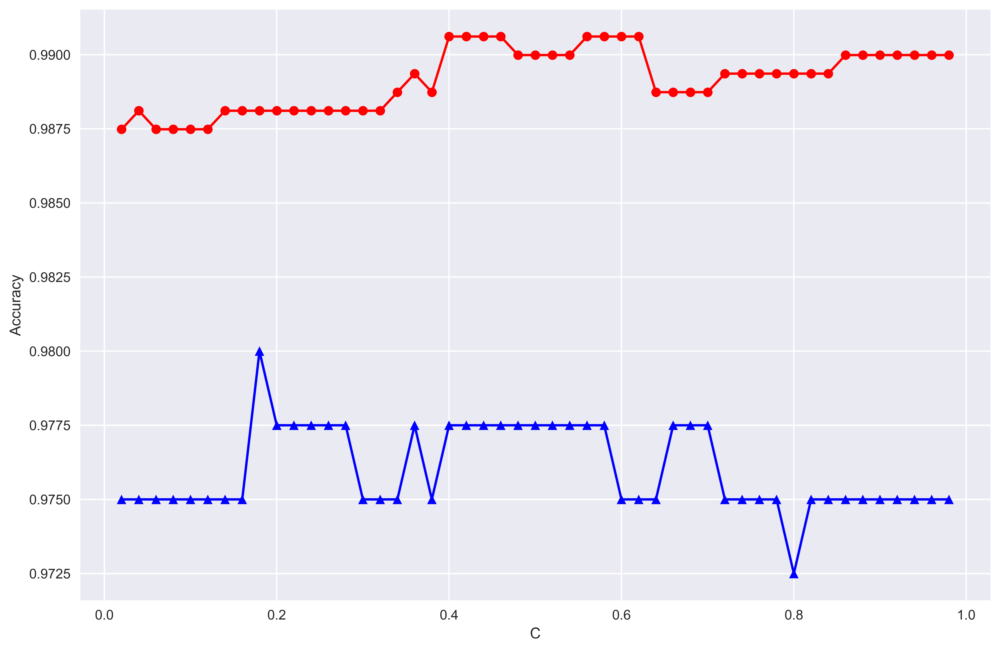

In [146]:
train_score, test_score = [], []
X, y = data.drop('price_range', axis = 1), data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

for c in np.arange(0.02, 1, 0.02):
    svm = SVC(random_state = 1, kernel = 'linear', decision_function_shape = 'ovo', C = c)
    svm.fit(X_train, y_train)
    train_score.append(svm.score(X_train, y_train))
    test_score.append(svm.score(X_test, y_test))

print(len(train_score))
print(len(test_score))

plt.figure(figsize = (12, 8), dpi = 600)
plt.plot(np.arange(0.02, 1, 0.02), train_score, marker = 'o', color = 'red', label = 'Train')
plt.plot(np.arange(0.02, 1, 0.02), test_score, marker = '^', color = 'blue', label = 'Test')
plt.xlabel('C')
plt.ylabel('Accuracy')
plt.show()

*Regarding the plot above, model with "linear" kernel performs best when "C" is equal to 0.18*

In [147]:
svm = SVC(random_state = 1, kernel = 'linear', decision_function_shape = 'ovo', C = 0.18)
X, y = data.drop('price_range', axis = 1), data['price_range']
kfold = KFold(n_splits = 5, shuffle = True, random_state = 1)
cross_val_score(svm, X, y, scoring = 'accuracy', cv = kfold)

array([0.98      , 0.97      , 0.97      , 0.98496241, 0.96741855])

*The performance of the model showed a reliable consistency.*

In [148]:
X, y = data.drop('price_range', axis = 1), data['price_range']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, shuffle = True, random_state = 1)

In [149]:
svm.fit(X_train, y_train)

SVC(C=0.18, decision_function_shape='ovo', kernel='linear', random_state=1)

In [150]:
print('Train')
multi_class_metrics(y_train, svm.predict(X_train))
print('\nTest')
multi_class_metrics(y_test, svm.predict(X_test))

Train
Accuracy  :  0.988
Precision :  0.988
Recall    :  0.988
f1        :  0.988

Test
Accuracy  :  0.98
Precision :  0.98
Recall    :  0.98
f1        :  0.98


In [151]:
print('Train')
print(metrics.classification_report(y_train, svm.predict(X_train)))
print('\nTest')
print(metrics.classification_report(y_test, svm.predict(X_test)))

Train
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       399
           1       0.99      0.98      0.98       408
           2       0.98      0.98      0.98       397
           3       0.99      0.99      0.99       394

    accuracy                           0.99      1598
   macro avg       0.99      0.99      0.99      1598
weighted avg       0.99      0.99      0.99      1598


Test
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       101
           1       0.99      0.97      0.98        91
           2       0.94      0.99      0.97       103
           3       1.00      0.96      0.98       105

    accuracy                           0.98       400
   macro avg       0.98      0.98      0.98       400
weighted avg       0.98      0.98      0.98       400



*Among all the algorithms, "SVM" performed best. Also, the probelm with the previous models and the target classes "1" and "2" is not an issue with the SVM model.*

In [152]:
X_test['Predicted'] = svm.predict(X_test)
X_test['True'] = y_test

<ipython-input-152-a270ddee569f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['Predicted'] = svm.predict(X_test)
<ipython-input-152-a270ddee569f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['True'] = y_test


<Figure size 130000x140000 with 0 Axes>

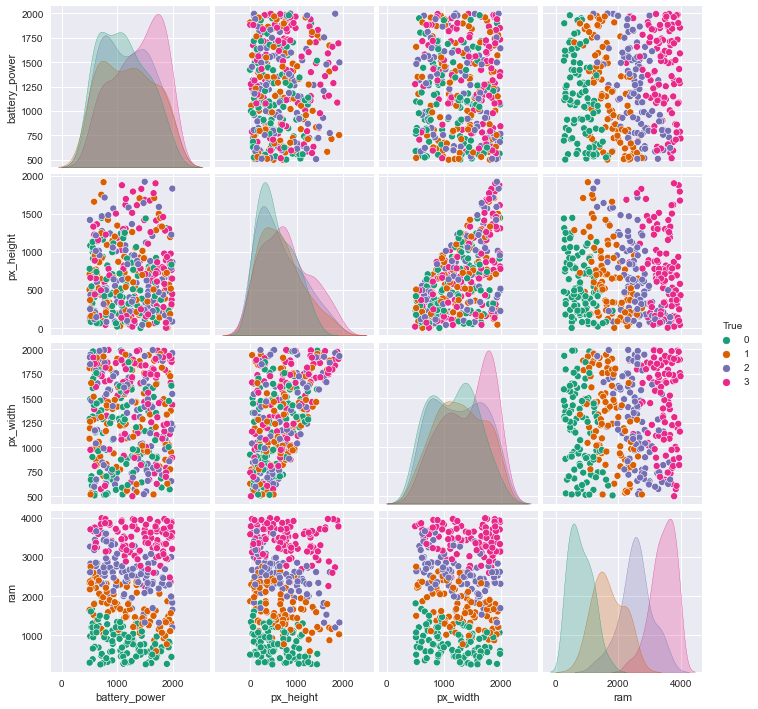

In [153]:
plt.figure(figsize = (130, 140), dpi = 1000)
sns.pairplot(X_test[used_features + ['True']] ,hue='True', palette='Dark2')
plt.show()

<Figure size 130000x140000 with 0 Axes>

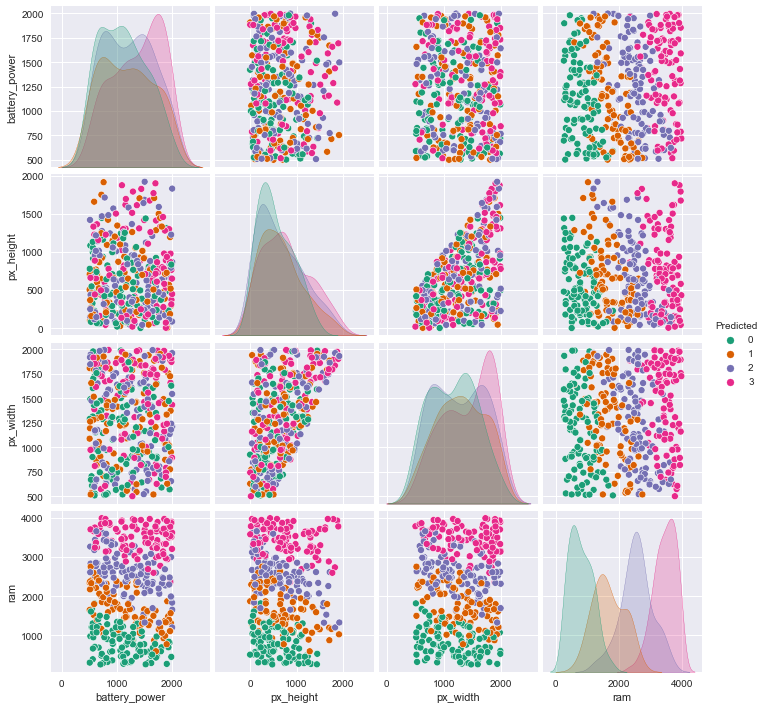

In [154]:
plt.figure(figsize = (130, 140), dpi = 1000)
sns.pairplot(X_test[used_features + ['Predicted']] ,hue='Predicted', palette='Dark2')
plt.show()

*It can be seen that the model's prediction power is no way near of its counterparts. Classes separability is retained along each feature. However, along some features, such as "px_width", the difference between the train reuslts and test resualts are more obvious.*

#### **Best Support Vector Machine** : 
* **Hyperparameters** : **kernel** = 'linear', **decision_function_shape** = 'ovo', **C** = 0.18

### **Final Model and Prediction**

In [155]:
model = SVC(kernel = 'linear', decision_function_shape = 'ovo', C = 0.18)

In [156]:
X = data.drop('price_range', axis = 1)
y = data['price_range']

In [157]:
model.fit(X, y)

SVC(C=0.18, decision_function_shape='ovo', kernel='linear')

In [158]:
test_data = pd.read_csv('E:/Downloads/mobile_test.csv')
test_data

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,3,16,226,1412,3476,12,7,2,0,1,0
1,2,841,1,0.5,1,4,1,61,0.8,191,5,12,746,857,3895,6,0,7,1,0,0
2,3,1807,1,2.8,0,1,0,27,0.9,186,3,4,1270,1366,2396,17,10,10,0,1,1
3,4,1546,0,0.5,1,18,1,25,0.5,96,8,20,295,1752,3893,10,0,7,1,1,0
4,5,1434,0,1.4,0,11,1,49,0.5,108,6,18,749,810,1773,15,8,7,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,1700,1,1.9,0,0,1,54,0.5,170,7,17,644,913,2121,14,8,15,1,1,0
996,997,609,0,1.8,1,0,0,13,0.9,186,4,2,1152,1632,1933,8,1,19,0,1,1
997,998,1185,0,1.4,0,1,1,8,0.5,80,1,12,477,825,1223,5,0,14,1,0,0
998,999,1533,1,0.5,1,0,0,50,0.4,171,2,12,38,832,2509,15,11,6,0,1,0


In [159]:
test_data.drop('id', axis = 1, inplace = True)
test_data.drop('sc_w', axis = 1, inplace = True)

In [160]:
test_data.isnull().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
dtype: int64

In [161]:
test_data.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,talk_time,three_g,touch_screen,wifi
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000
mean,1248.510000,0.516000,1.540900,0.517000,4.593000,0.487000,33.652000,0.517500,139.51100,4.328000,10.054000,627.121000,1239.774000,2138.998000,11.995000,11.085000,0.756000,0.50000,0.507000
std,432.458227,0.499994,0.829268,0.499961,4.463325,0.500081,18.128694,0.280861,34.85155,2.288155,6.095099,432.929699,439.670981,1088.092278,4.320607,5.497636,0.429708,0.50025,0.500201
min,500.000000,0.000000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.00000,1.000000,0.000000,0.000000,501.000000,263.000000,5.000000,2.000000,0.000000,0.00000,0.000000
25%,895.000000,0.000000,0.700000,0.000000,1.000000,0.000000,18.000000,0.300000,109.75000,2.000000,5.000000,263.750000,831.750000,1237.250000,8.000000,6.750000,1.000000,0.00000,0.000000
50%,1246.500000,1.000000,1.500000,1.000000,3.000000,0.000000,34.500000,0.500000,139.00000,4.000000,10.000000,564.500000,1250.000000,2153.500000,12.000000,11.000000,1.000000,0.50000,1.000000
75%,1629.250000,1.000000,2.300000,1.000000,7.000000,1.000000,49.000000,0.800000,170.00000,6.000000,16.000000,903.000000,1637.750000,3065.500000,16.000000,16.000000,1.000000,1.00000,1.000000
max,1999.000000,1.000000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.00000,8.000000,20.000000,1907.000000,1998.000000,3989.000000,19.000000,20.000000,1.000000,1.00000,1.000000


In [164]:
test_data['px_height'].replace(0, np.nan, inplace = True)
test_data.isnull().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        2
px_width         0
ram              0
sc_h             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
dtype: int64

In [165]:
test_data.dropna(inplace = True)
test_data.reset_index(drop = True, inplace = True)

In [166]:
for i in range(len(data.columns) - 1):
    if data.columns[i] != test_data.columns[i]:
        print(test_data.columns[i])
        
print('-')

-


In [167]:
y_pred = model.predict(test_data)
y_pred

array([3, 3, 2, 3, 1, 3, 3, 1, 3, 0, 3, 3, 0, 0, 2, 0, 2, 1, 3, 2, 1, 3,
       1, 1, 3, 0, 2, 0, 3, 0, 2, 0, 3, 0, 0, 1, 3, 1, 2, 1, 1, 2, 0, 0,
       0, 1, 0, 3, 1, 2, 1, 0, 3, 0, 3, 1, 3, 1, 1, 3, 3, 3, 0, 1, 1, 1,
       2, 3, 1, 2, 1, 2, 2, 3, 3, 0, 2, 0, 2, 3, 0, 3, 3, 0, 3, 0, 3, 1,
       3, 0, 1, 2, 2, 1, 2, 2, 1, 2, 1, 2, 1, 0, 0, 3, 0, 2, 0, 1, 2, 3,
       3, 3, 1, 3, 3, 3, 3, 2, 3, 0, 0, 3, 2, 1, 2, 0, 3, 2, 3, 1, 0, 2,
       2, 1, 3, 1, 1, 0, 3, 2, 1, 2, 1, 3, 2, 3, 3, 3, 2, 3, 2, 3, 1, 0,
       3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 3, 1, 0, 3, 0, 0, 0, 2, 1, 0, 1,
       0, 0, 1, 2, 1, 0, 0, 1, 1, 2, 2, 1, 0, 0, 0, 1, 0, 3, 1, 0, 2, 2,
       3, 3, 1, 2, 2, 2, 3, 2, 2, 1, 1, 0, 1, 2, 0, 2, 3, 3, 0, 2, 0, 3,
       2, 3, 3, 1, 0, 1, 0, 3, 0, 1, 0, 2, 2, 1, 3, 1, 3, 0, 3, 1, 2, 0,
       0, 2, 1, 3, 3, 3, 1, 1, 3, 0, 0, 2, 3, 3, 1, 3, 1, 1, 3, 2, 1, 2,
       3, 3, 3, 1, 0, 1, 2, 3, 1, 1, 3, 2, 0, 3, 0, 0, 2, 1, 0, 3, 2, 3,
       3, 2, 1, 3, 3, 2, 3, 1, 2, 1, 2, 0, 2, 3, 1,

In [168]:
test_data['price_range'] = y_pred

In [169]:
len(data)

1998

In [170]:
total_data = data.append(test_data, ignore_index = True)
total_data

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20.0,756,2549,9,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905.0,1988,2631,17,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263.0,1716,2603,11,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216.0,1786,2769,16,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208.0,1212,1411,8,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2991,1700,1,1.9,0,0,1,54,0.5,170,7,17,644.0,913,2121,14,15,1,1,0,2
2992,609,0,1.8,1,0,0,13,0.9,186,4,2,1152.0,1632,1933,8,19,0,1,1,1
2993,1185,0,1.4,0,1,1,8,0.5,80,1,12,477.0,825,1223,5,14,1,0,0,0
2994,1533,1,0.5,1,0,0,50,0.4,171,2,12,38.0,832,2509,15,6,0,1,0,2


<Figure size 130000x140000 with 0 Axes>

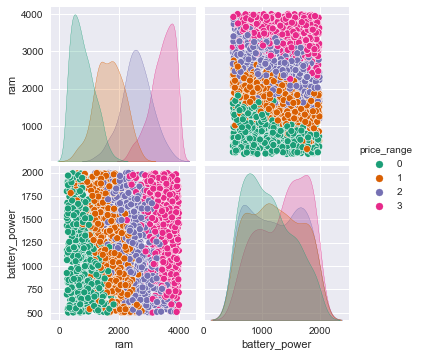

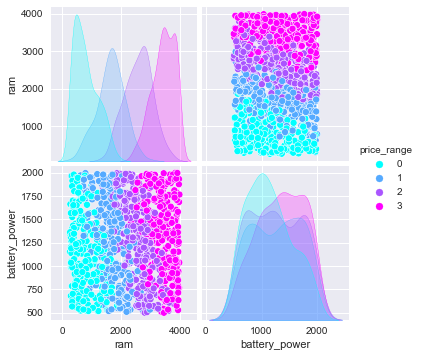

In [171]:
plt.figure(figsize = (130, 140), dpi = 1000)
sns.pairplot(total_data.loc[:1998, ['ram', 'battery_power', 'price_range']] ,hue='price_range', palette='Dark2')
sns.pairplot(total_data.loc[1998:, ['ram', 'battery_power', 'price_range']] ,hue='price_range', palette='cool')
plt.show()

*Visualizing the real data vs the predicted data, it can be seen that the distribution of the classes along the most important features, **"ram"** and **"battery_power"**, with the predicted target values, resembles the distributions of classes in the real data.*

## **Model**

In [172]:
model = SVC(kernel = 'linear', decision_function_shape = 'ovo', C = 0.18)